# Anomaly Detection Study on PaySim Dataset with Heightened Imbalance

I was given this dataset to study extremely imbalanced anomalies. There is an additional column named `Id`, which seems to be the index of the original dataset. The `Id` values are not continuous, i.e. some id's have been skipped. While I do not know the exact aim or method in this skipping and filtering, the result is that the ratio of fraudulent transactions is severely reduced, and so the anomaly detection problem is made that much harder.

**What changes are we talking about exactly?**
- While the original PaySim data features 8213 fraud cases in 6362620 transactions equaling a ratio of 0.0013, this filtered data features 178 fraud cases in 2372805 equaling a ratio of 0.000075.
- This dataset contains no information in the `isFlaggedFraud` column, even though there are transactions over 200,000 units. 
- The `type` column is called `action`. 
- The additional `Id` column was already mentioned above.

Lastly, you will need GPU acceleration to replicate some of the visualizations below.

Let's get started!

# Imports

In [1]:
# Data processing
import numpy as np
import pandas as pd
from scipy import stats
import io
import os
import datetime as dt
from sklearn.decomposition import PCA
import networkx as nx
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import LabelEncoder, RobustScaler, MinMaxScaler

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.stats import gaussian_kde
from plotly.tools import mpl_to_plotly

import cudf
import cupy as cp
import plotly.express as px

# Oversampling and undersampling
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler, NearMiss
from collections import Counter

# Modelling and performance
from sklearn.metrics import make_scorer, recall_score, precision_score, f1_score, roc_auc_score, roc_curve, auc, precision_recall_curve, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, cross_validate, cross_val_score, StratifiedKFold, TimeSeriesSplit, GridSearchCV
from sklearn.ensemble import RandomForestClassifier, IsolationForest, GradientBoostingClassifier, VotingClassifier, AdaBoostClassifier
from imblearn.ensemble import BalancedRandomForestClassifier, EasyEnsembleClassifier, BalancedBaggingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.mixture import GaussianMixture
from xgboost import XGBClassifier

from keras.layers import Dense
from keras.models import Sequential
from sklearn.utils import class_weight

import time
import logging
import json
import warnings

pd.set_option('display.max_columns', None)
pd.set_option('display.width', 500)
pd.options.display.float_format = '{:,.2f}'.format
warnings.filterwarnings('ignore', category=FutureWarning)

# Base Model

In [ ]:
df = pd.read_csv('/kaggle/input/paysim-filtered/train.csv')

df.drop(['Id', 'nameOrig', 'nameDest'], axis=1, inplace=True)
df = pd.get_dummies(df, columns=['action'], drop_first=True, dtype=int)

X = df.drop(["isFraud"], axis=1)
y = df["isFraud"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

I will use a basic Random Forest since it:

- is robust to missing values,
- is insensitive to outliers,
- can provide early insights into feature importance to guide my exploratory data analysis (EDA) and preprocessing steps,
- has reasonable performance on default settings,
- handles class imbalance better than many models due to its ensemble nature.

In fraud detection problems, the metric to optimize is positive class recall. Failing to detect a fraudulent transaction can result in significant financial loss, making a false negative very costly.

In [ ]:
rf = RandomForestClassifier(random_state=42)
baseline_rf = rf.fit(X_train, y_train)

baseline_rf_cv = cross_validate(rf, X_train, y_train, cv = 5, n_jobs = -1, scoring="recall")

y_pred = baseline_rf.predict(X_test)
y_prob = baseline_rf.predict_proba(X_test)[:, 1]

print(f"The 5-fold cross validation gives the recall value of {baseline_rf_cv['test_score'].mean():.3f} and the standard deviation of {baseline_rf_cv['test_score'].std():.3f}.")
print(f"AUC-ROC score is {roc_auc_score(y_test, y_prob)} \n")
print("Classification report:")
print(classification_report(y_test, y_pred))

The 5-fold cross validation gives the recall value of 0.762 and the standard deviation of 0.087.
AUC-ROC score is 0.9833238502858612 

Classification report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    474531
           1       1.00      0.97      0.98        30

    accuracy                           1.00    474561
   macro avg       1.00      0.98      0.99    474561
weighted avg       1.00      1.00      1.00    474561



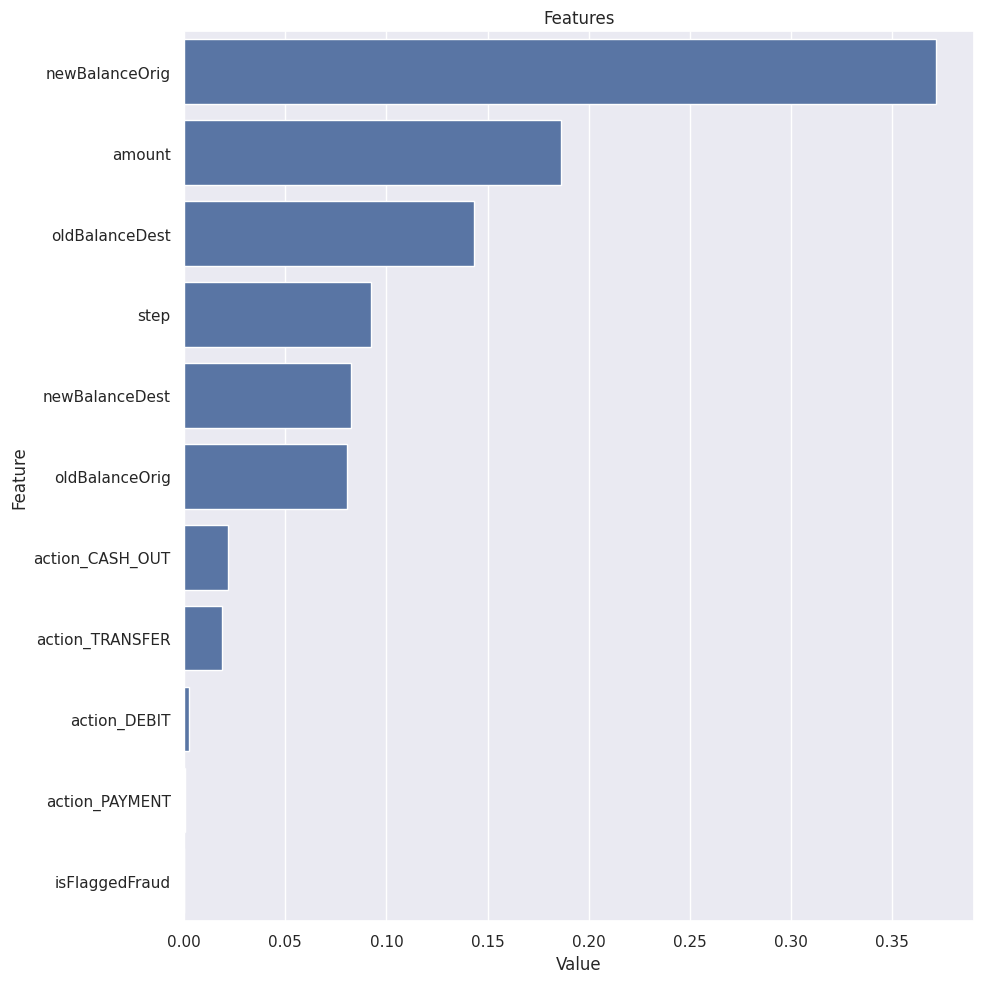

In [ ]:
def plot_importance(model, features, num=len(X), save=False):
    feature_imp = pd.DataFrame({'Value': model.feature_importances_, 'Feature': features.columns})
    plt.figure(figsize=(10, 10))
    sns.set(font_scale=1)
    sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value",
                                                                     ascending=False)[0:num])
    plt.title('Features')
    plt.tight_layout()
    plt.show()
    if save:
        plt.savefig('importances.png')

plot_importance(baseline_rf, X)

# Exploratory Data Analysis

In [5]:
df = pd.read_csv('/kaggle/input/paysim-filtered/train.csv')

def check_df(dataframe, head=5):
    print("##################### Shape #####################")
    print(dataframe.shape)
    print("##################### Types #####################")
    print(dataframe.dtypes)
    print("##################### Head #####################")
    print(dataframe.head(head))
    print("##################### Tail #####################")
    print(dataframe.tail(head))
    print("##################### NaN #####################")
    print(dataframe.isnull().sum())
    print("##################### Quantiles #####################")
    print(dataframe.describe([0, 0.05, 0.50, 0.95, 0.99, 1]))

check_df(df)
df["isFraud"].value_counts()

##################### Shape #####################
(2372805, 12)
##################### Types #####################
Id                  int64
step                int64
action             object
amount            float64
nameOrig           object
oldBalanceOrig    float64
newBalanceOrig    float64
nameDest           object
oldBalanceDest    float64
newBalanceDest    float64
isFraud             int64
isFlaggedFraud      int64
dtype: object
##################### Head #####################
   Id  step    action     amount     nameOrig  oldBalanceOrig  newBalanceOrig     nameDest  oldBalanceDest  newBalanceDest  isFraud  isFlaggedFraud
0   0     0  TRANSFER      10.00  C0198526315       30,112.00       30,102.00  C4653045645       21,927.84       21,937.84        0               0
1   1     1   CASH_IN 104,925.19  C9864462944           42.23      104,967.41  C7853342674            0.00            0.00        0               0
2   2     1   CASH_IN  37,383.17  C1474610910           49.83      

isFraud
0    2372627
1        178
Name: count, dtype: int64

In [6]:
df["isFlaggedFraud"].sum() # 0
any(df["amount"] > 200000) # True
df.drop('isFlaggedFraud', axis=1, inplace=True)

`isFlaggedFraud` consists entirely of 0's and carries no characteristic, so it is dropped.

Since the instructions state `isFlaggedFraud` is 1 for transactions over 200,000 units, this discrepancy may be due to an error in the flagging system or a result of the synthetic nature of the dataset.

<Figure size 1200x800 with 0 Axes>

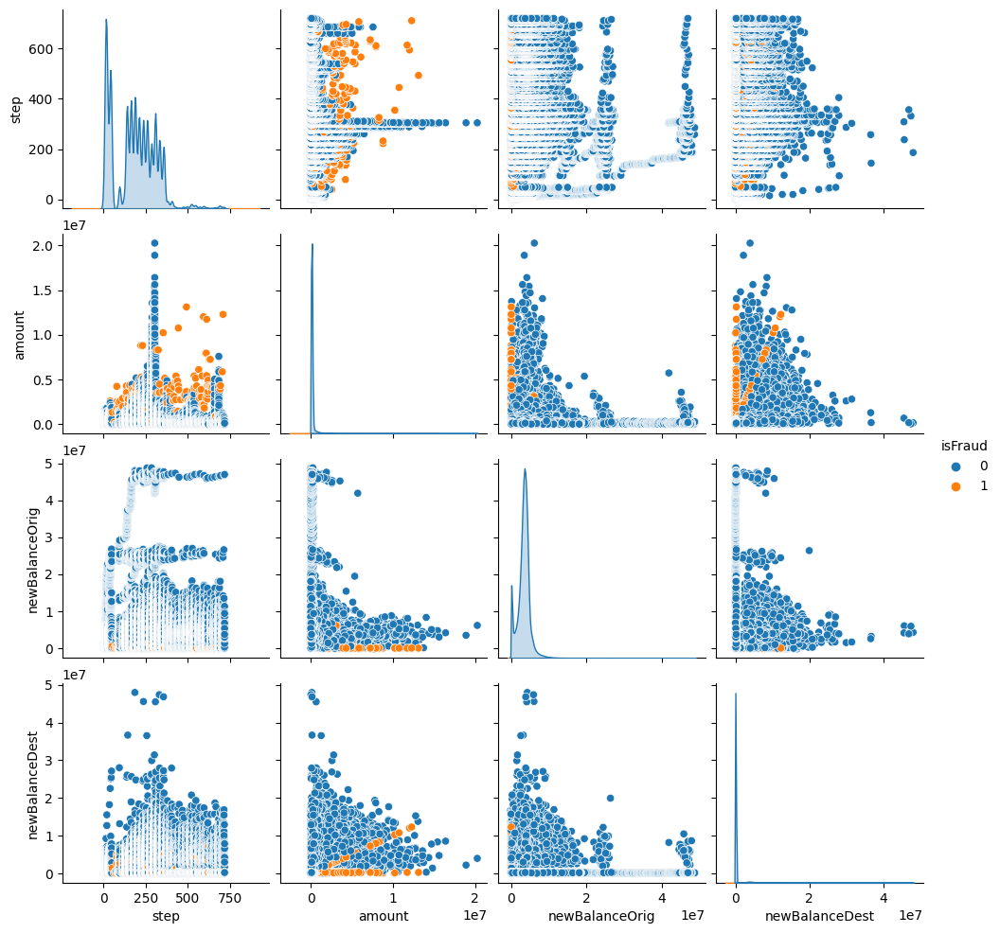

In [9]:
plt.figure(figsize=(12,8)) 
sns.pairplot(df[['step', 'amount', 'newBalanceOrig', 'newBalanceDest', 'isFraud']], hue='isFraud')

In [ ]:
# Convert the DataFrame to cuDF for GPU acceleration
df_gpu = cudf.DataFrame(df)

df_gpu['isFraud'] = df_gpu['isFraud'].astype('category')

for col in ['step', 'amount', 'oldBalanceOrig', 'newBalanceOrig', 'oldBalanceDest', 'newBalanceDest']:
    df_gpu[col] = df_gpu[col].astype('float32')

In [ ]:
fig = px.scatter_matrix(
    df_gpu.to_pandas(),
    dimensions=['step', 'amount', 'newBalanceOrig', 'newBalanceDest'],
    color='isFraud', title="Pairplot of Features", height=800, width=1200)

fig.show()

Buffered data was truncated after reaching the output size limit.

In [ ]:
# Create pairplot-like visualization with Plotly
fig = px.scatter_matrix(
    df_gpu.to_pandas(),  # Plotly doesn't directly support cuDF, so convert to pandas here
    dimensions=['amount', 'oldBalanceOrig', 'newBalanceOrig', 'oldBalanceDest', 'newBalanceDest'],
    color='isFraud',
    title="Pairplot of Features (GPU-Optimized)",
    height=800,
    width=1200
)

fig.show()

Buffered data was truncated after reaching the output size limit.

## Id

In [ ]:
df["Id"].duplicated().any()
# False
# df.drop('Id', axis=1, inplace=True)

False

I had initially thought the `Id` column mirrorred the index and dropped it straightaway, but then realized from the tail view of the dataframe that `Id` goes up over 3M while index ends at a little over 2M. So we investigate:

In [8]:
df = df.sort_values('Id')
df['Id_diff'] = df['Id'].diff()

# The first row will have NaN, so we can fill it with 0 or drop it
df['Id_diff'] = df['Id_diff'].fillna(0)

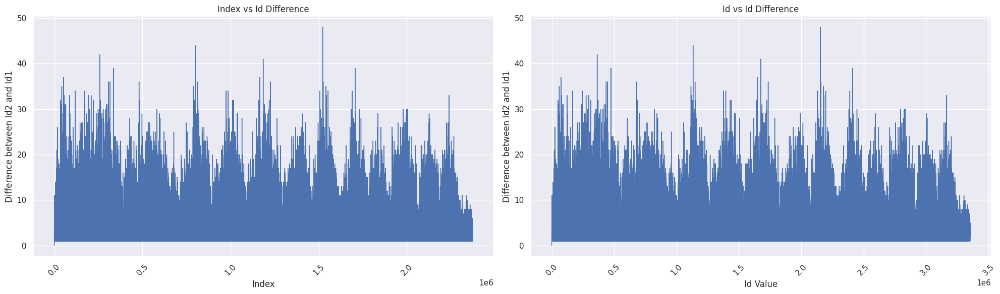

In [ ]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# Subplot 1: Index vs Id Difference
ax1.plot(df.index, df['Id_diff'], linewidth=1)
ax1.set_xlabel('Index')
ax1.set_ylabel('Difference between Id2 and Id1')
ax1.set_title('Index vs Id Difference')
ax1.tick_params(axis='x', rotation=45)

# Subplot 2: Id vs Difference
ax2.plot(df['Id'], df['Id_diff'], linewidth=1)
ax2.set_xlabel('Id Value')
ax2.set_ylabel('Difference between Id2 and Id1')
ax2.set_title('Id vs Id Difference')
ax2.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Let's take a closer look into the patterns by dividing the `Id` values on the X axis into 4 quarters:

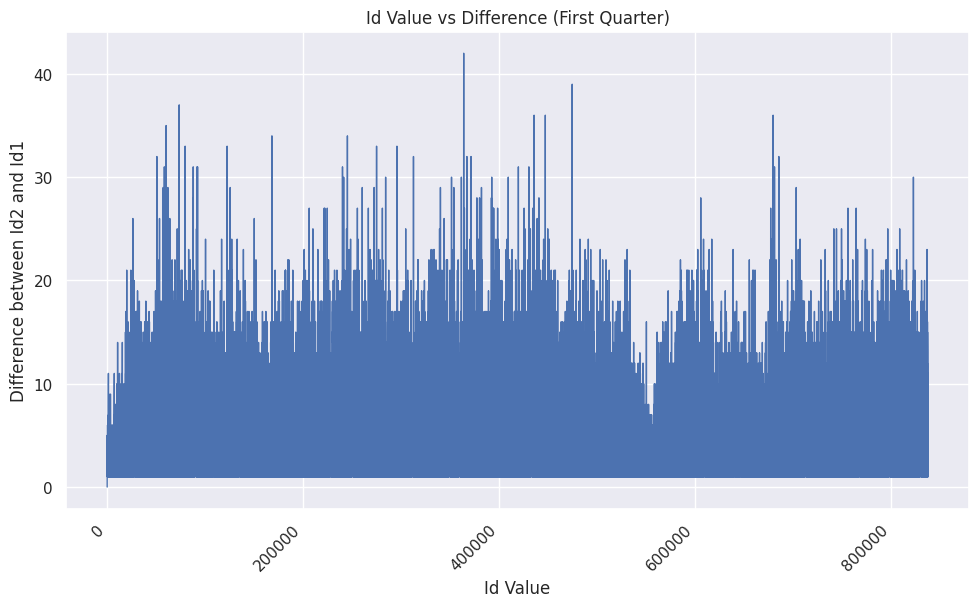

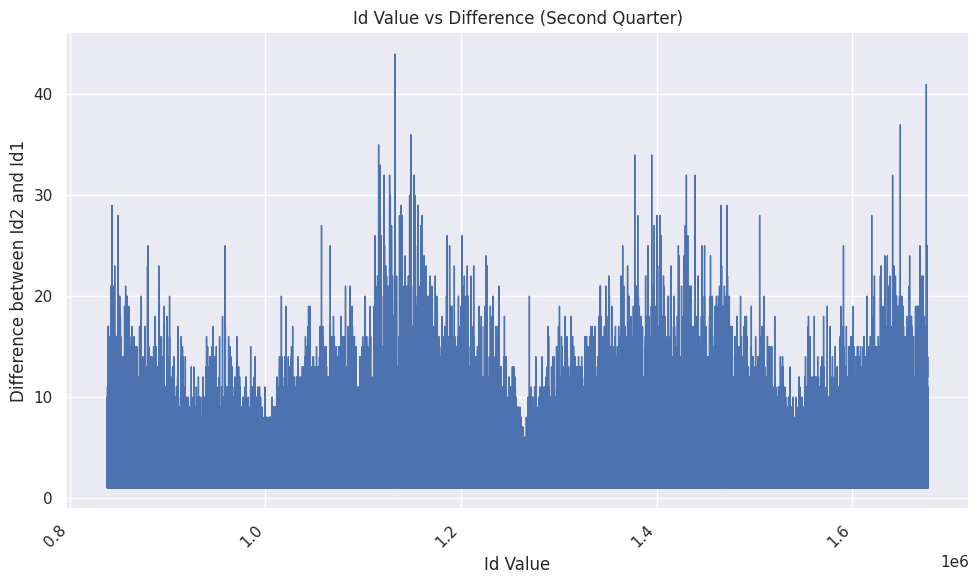

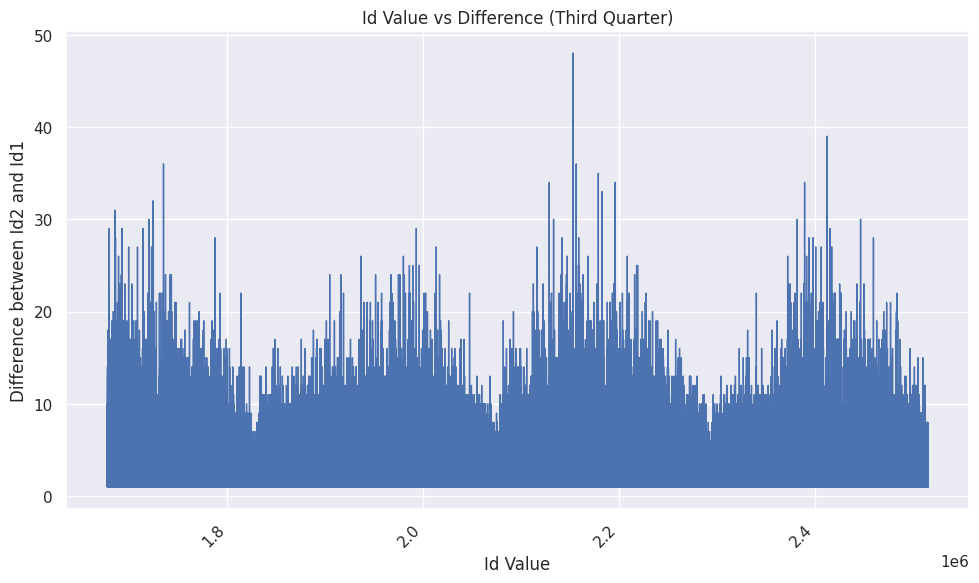

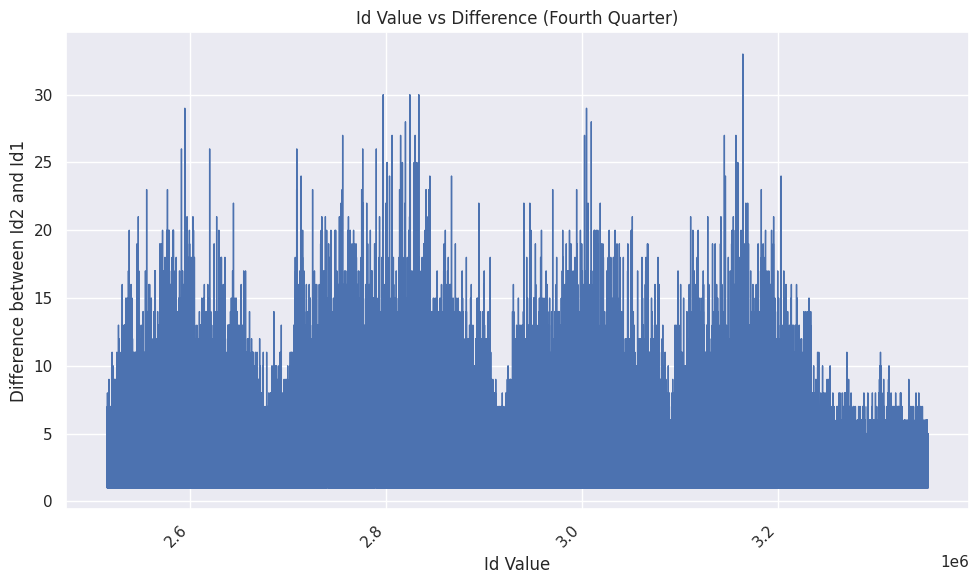

In [ ]:
# Calculate the first third of the indexes
num_rows = len(df)

# Define the bounds for each third
first_quarter = num_rows // 4
second_quarter = 2 * num_rows // 4
third_quarter = 3 * num_rows // 4

# Slice the dataframe for each segment
first_segment = df.iloc[:first_quarter]
second_segment = df.iloc[first_quarter:second_quarter]
third_segment = df.iloc[second_quarter:third_quarter]
fourth_segment = df.iloc[third_quarter:]

def plot_quarter(df, segment, quarter_number, ):
    plt.figure(figsize=(10, 6))
    plt.xlabel('Id Value')
    plt.ylabel('Difference between Id2 and Id1')
    plt.title(f'Id Value vs Difference ({quarter_number} Quarter)')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.plot(segment['Id'], segment['Id_diff'], label=f'{quarter_number} Quarter', linewidth=1)
    plt.show()

plot_quarter(df, first_segment, 'First')
plot_quarter(df, second_segment, 'Second')
plot_quarter(df, third_segment, 'Third')
plot_quarter(df, fourth_segment, 'Fourth')

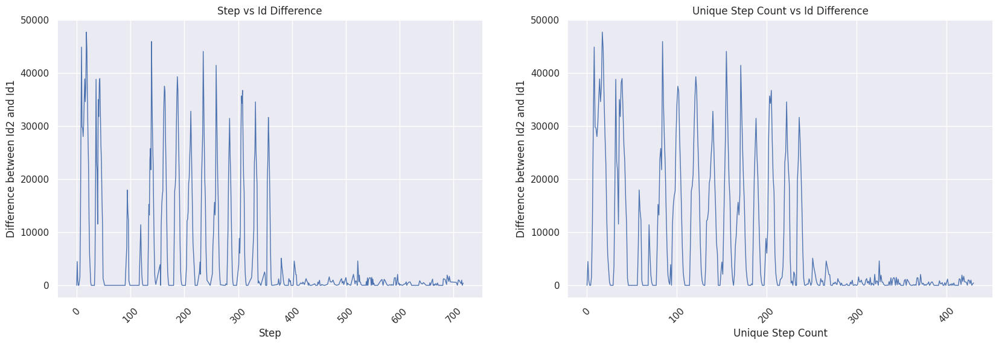

In [ ]:
df1 = df.groupby('step')['Id_diff'].sum()
df1 = df1.to_frame()
df1.reset_index(inplace=True)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# Subplot 1: Step vs Id Difference
ax1.plot(df1['step'], df1['Id_diff'], linewidth=1)
ax1.set_xlabel('Step')
ax1.set_ylabel('Difference between Id2 and Id1')
ax1.set_title('Step vs Id Difference')
# plt.xticks(rotation=45, ha='right')
ax1.tick_params(axis='x', rotation=45)


# Subplot 2: Id vs Difference
ax2.plot(df1['step'].index, df1['Id_diff'], linewidth=1)
ax2.set_xlabel('Unique Step Count')
ax2.set_ylabel('Difference between Id2 and Id1')
ax2.set_title('Unique Step Count vs Id Difference')
# plt.xticks(rotation=45, ha='right')
ax2.tick_params(axis='x', rotation=45)

## Accounts

How many unique accounts are there?

In [ ]:
print(df["nameOrig"].nunique(), "unique accounts in nameOrig")
print(df["nameDest"].nunique(), "unique accounts in nameDest")

14141 unique accounts in nameOrig
54904 unique accounts in nameDest


<br>

<br>

Top origin and destination accounts in fraudulent transactions:

In [9]:
df.groupby('nameOrig').agg({'nameOrig': 'count', 'isFraud': 'sum'}).sort_values('isFraud', ascending=False).head()

,nameOrig,isFraud
nameOrig,,
C7135476180,2,2
C1046099459,1,1
C7201710176,1,1
C8473039269,1,1
C6533130079,195,1


In [10]:
df.groupby('nameDest').agg({'nameDest': 'count', 'isFraud': 'sum'}).sort_values('isFraud', ascending=False).head()

,nameDest,isFraud
nameDest,,
C7645702311,66,2
C4394911792,64,1
C5980773872,62,1
C5585611570,64,1
C1447436877,6,1


<br>

<br>

Do all account names start with the letter `C`?

In [11]:
nameOrig_non_C = df.loc[~df["nameOrig"].str.startswith("C"), "nameOrig"]
nameDest_non_C = df.loc[~df["nameDest"].str.startswith("C"), "nameDest"]

non_C_values = pd.concat([nameOrig_non_C, nameDest_non_C])
non_C_counts = non_C_values.str[0].value_counts()

# Relation to fraud:
df_B_nameDest = df[df["nameDest"].str.startswith("B")]
df_B_nameDest["action"].value_counts()
df_B_nameDest["isFraud"].mean()

df_B_nameDest[["oldBalanceDest", "newBalanceDest"]].describe()

,oldBalanceDest,newBalanceDest
count,"88,122.00","88,122.00"
mean,0.00,0.00
std,0.00,0.00
min,0.00,0.00
25%,0.00,0.00
50%,0.00,0.00
75%,0.00,0.00
max,0.00,0.00


There are 88122 accounts starting with the letter `B` instead of `C`. They all belong to the `nameDest` variable when the `action` variable set to `DEBIT`. None of these observations are fraud, and all their `oldBalanceDest` and `newBalanceDest` values are 0.

These transactions look like money sent outside the app into banking institutions, hence the letter `B`. This also explains the `oldBalanceDest` and `newBalanceDest` variables defaulting to 0 due to the lack of information on destination balance from outside institutions.

<br>

<br>

How many transactions have origin accounts made on average?

In [ ]:
df.shape[0] / df["nameOrig"].nunique()

167.7961247436532

## Amount & Balance

In [9]:
df.groupby("isFraud")["amount"].mean()

isFraud
0     145,196.16
1   3,554,502.27
Name: amount, dtype: float64

In [10]:
fig = go.Figure()
fig = px.box(df, x='isFraud', y='amount',
             title="Distribution of Amount by Fraud Status",
             height=600, width=900)
fig.show()

The box plot shows that the `amount` data is extremely right skewed. Further details of the distribution can be seen when hovering over the boxes: The max value is 20M, 75% percentile is 171k, while median is 98k.

In [14]:
df["changeOrig"] = abs(df["oldBalanceOrig"] - df["newBalanceOrig"])
df["changeDest"] = abs(df["newBalanceDest"] - df["oldBalanceDest"])

<br>

<br>

Some observations balance values show no change on either the origin or destination, despite the `amount` being nonzero. Let's investigate this by each `action` type.

## Action

In [11]:
df["action"].value_counts()

action
CASH_IN     1032064
CASH_OUT     560152
PAYMENT      553096
TRANSFER     139371
DEBIT         88122
Name: count, dtype: int64

In [19]:
df.groupby("action")["isFraud"].sum()

action
CASH_IN      0
CASH_OUT    94
DEBIT        0
PAYMENT      0
TRANSFER    84
Name: isFraud, dtype: int64

In [ ]:
fig = px.box(df, x='action', y='amount', color='isFraud',
             title="Distribution of Amount by Action and Fraud Status",
             height=600, width=900)
fig.show()

Buffered data was truncated after reaching the output size limit.

<br>

<br>

Has the receiving account been used for cashing out?


In [ ]:
dfFraudTransfer = df.loc[(df.isFraud == 1) & (df.action == 'TRANSFER')]
dfFraudCashout = df.loc[(df.isFraud == 1) & (df.action == 'CASH_OUT')]

dfFraudTransfer.nameDest.isin(dfFraudCashout.nameOrig).any()

True

Number of accounts that first `TRANSFER` money in, and then `CASH_OUT`:


In [ ]:
# Merge with TRANSFER rows where nameDest matches nameOrig
merged = df[df['action'] == 'TRANSFER'].merge(dfFraudCashout, left_on='nameDest', right_on='nameOrig',
                                              suffixes=('_transfer', '_cash_out'))

cashout_after_transfers = merged[merged['step_cash_out'] > merged['step_transfer']]

# Sum the isFraud for TRANSFER rows
cashout_after_transfers_count = cashout_after_transfers['isFraud_transfer'].sum()
print(cashout_after_transfers_count)

50


### Fraudulent action types

#### `TRANSFER`

In [20]:
df[df["action"] == "TRANSFER"][0:4]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
0,0,0,TRANSFER,10.00,C0198526315,"30,112.00","30,102.00",C4653045645,"21,927.84","21,937.84",0,0.00,10.00,10.00
22,30,1,TRANSFER,"262,738.68",C9753408640,21.82,21.82,C9779107888,27.15,27.15,0,1.00,0.00,0.00
519,705,1,TRANSFER,"107,519.32",C1507337155,65.60,65.60,C7448466496,14.94,14.94,0,1.00,0.00,0.00
1397,1949,1,TRANSFER,"244,690.96",C4448860867,47.70,47.70,C9479065461,42.57,42.57,0,1.00,0.00,0.00


The bottom three of the observations in the output above show no change between `oldBalanceDest` and `newBalanceDest`.


In [21]:
df[df["action"] == "TRANSFER"].tail(4)

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
2372769,3352838,718,TRANSFER,"88,499.03",C4344520953,"6,861,048.18","6,772,549.16",C9884961235,"2,723,795.40","2,812,294.43",0,1.00,"88,499.02","88,499.03"
2372784,3352854,718,TRANSFER,"134,481.21",C0329481515,"3,305,553.70","3,171,072.48",C5550792131,"2,834,057.54","2,968,538.75",0,2.00,"134,481.22","134,481.21"
2372788,3352860,718,TRANSFER,"78,319.88",C6584892293,"4,656,861.64","4,578,541.76",C3772194834,"6,514,844.39","6,593,164.26",0,3.00,"78,319.88","78,319.87"
2372800,3352878,718,TRANSFER,"365,959.08",C0575993734,"9,750,032.16","9,384,073.08",C0205431023,"7,479,928.58","7,845,887.66",0,1.00,"365,959.08","365,959.08"


In [15]:
print(df[(df["action"] == "TRANSFER") & (df["changeOrig"] == 0) & (df["changeDest"] == 0)].shape[0])
print(df[(df["action"] == "TRANSFER") & (df["changeOrig"] == 0) & (df["changeDest"] == 0)]["isFraud"].sum())

6896
0


This may indicate cancelled transactions.
<br>

<br>


#### `CASH_OUT`

In [22]:
df[df["action"] == "CASH_OUT"][0:4]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
47,66,1,CASH_OUT,"87,813.45",C4048877384,"165,279.08","77,465.63",C3099442794,0.00,0.00,0,2.00,"87,813.45",0.00
288,384,1,CASH_OUT,"15,458.06",C5917269499,64.60,"-15,393.46",C3997129281,0.00,0.00,0,1.00,"15,458.06",0.00
1172,1624,1,CASH_OUT,"43,739.06",C9138794945,"-11,395.28","-11,395.28",C5810713478,0.00,0.00,0,1.00,0.00,0.00
1399,1951,1,CASH_OUT,"46,767.78",C4448860867,47.70,47.70,C3316800170,0.00,0.00,0,1.00,0.00,0.00


In [23]:
df[df["action"] == "CASH_OUT"].tail(4)

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
2372793,3352869,718,CASH_OUT,"87,025.47",C5141825778,"3,839,576.86","3,752,551.39",C1328398566,"191,502.48","191,502.48",0,5.00,"87,025.47",0.00
2372796,3352874,718,CASH_OUT,"156,668.53",C9217207764,"3,032,012.70","2,875,344.17",C6410277530,"136,488.21","136,488.21",0,1.00,"156,668.53",0.00
2372798,3352876,718,CASH_OUT,"90,602.36",C1385233834,"5,305,811.61","5,215,209.25",C1482177509,"236,013.31","236,013.31",0,1.00,"90,602.36",0.00
2372801,3352879,718,CASH_OUT,"51,782.58",C8713379202,"3,457,100.71","3,405,318.13",C2547402522,"159,726.22","159,726.22",0,1.00,"51,782.58",0.00


In [ ]:
df[(df["action"] == "CASH_OUT") & (df["changeDest"] > 0)].any().any()

False

Is information about the destination balance of a `CASH_OUT` transaction provided when the destination is another internal customer account? Maybe balance information is set to 0 when the destination is external (e.g. an ATM or other untracked endpoint) and the information is not part of the system. Let's investigate:

In [26]:
cash_out_zero_balance = set(df[(df['action'] == 'CASH_OUT') & (df['newBalanceDest'] == 0)]['nameDest'])
cash_out_non_zero_balance = set(df[(df['action'] == 'CASH_OUT') & (df['newBalanceDest'] != 0)]['nameDest'])

overlap = cash_out_zero_balance.intersection(cash_out_non_zero_balance)

print(f"Number of unique nameDest with CASH_OUT and zero balance: {len(cash_out_zero_balance)}")
print(f"Number of unique nameDest with CASH_OUT and non-zero balance: {len(cash_out_non_zero_balance)}")
print(f"Number of overlapping nameDest: {len(overlap)}")

if overlap:
    print("\nSome examples of overlapping nameDest:")
    for name in list(overlap)[:5]:
        print(name)
    origoverlap = overlap.intersection(set(df["nameOrig"]))
    print("\nThose overlaps who are both in nameOrig and nameDest:")
    print(list(origoverlap)[:5])
else:
    print("\nThere is no overlap between the two sets.")

Number of unique nameDest with CASH_OUT and zero balance: 15100
Number of unique nameDest with CASH_OUT and non-zero balance: 34753
Number of overlapping nameDest: 15099

Some examples of overlapping nameDest:
C5391567597
C7040829494
C6140887877
C6827104740
C6444199990

Those overlaps who are both in nameOrig and nameDest:
[]


In [24]:
df[(df['action'] == 'CASH_OUT') & (df['nameDest'] == "C2013180358")].head()

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
235170,332890,17,CASH_OUT,"102,063.07",C5928060083,"490,019.69","387,956.62",C2013180358,0.00,0.00,0,1.00,"102,063.07",0.00
321068,454342,20,CASH_OUT,"35,625.78",C4987316047,"4,329,165.05","4,293,539.27",C2013180358,0.00,0.00,0,1.00,"35,625.78",0.00
389348,550558,24,CASH_OUT,"225,853.98",C6632122345,"2,592,332.92","2,366,478.94",C2013180358,"6,404.84","6,404.84",0,1.00,"225,853.98",0.00
526324,744149,42,CASH_OUT,"47,432.51",C3051919887,"2,922,248.36","2,874,815.85",C2013180358,"29,441.43","29,441.43",0,1.00,"47,432.51",0.00
611149,864211,45,CASH_OUT,"88,130.11",C7503261758,"3,428,290.15","3,340,160.04",C2013180358,"29,441.43","29,441.43",0,1.00,"88,130.11",0.00


15099 out of 15100 accounts have both zero and nonzero values in `newBalanceDest` for `CASH_OUT`.

Under my earlier hypothesis that 0 is the default for external destination customers' balances for `CASH_OUT`, these same customers should not have had nonzero `newBalanceDest` for `CASH_OUT`. Therefore, the presence of destination account numbers and balance information may be due to the way the accounting or banking processes of the internal system handles outbound money.

<br>

But why is change in origin balance 0 for some observations?

In [27]:
df[(df["action"] == "CASH_OUT") & (df["changeOrig"] == 0)]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest
1172,1624,1,CASH_OUT,"43,739.06",C9138794945,"-11,395.28","-11,395.28",C5810713478,0.00,0.00,0,1.00,0.00,0.00
1399,1951,1,CASH_OUT,"46,767.78",C4448860867,47.70,47.70,C3316800170,0.00,0.00,0,1.00,0.00,0.00
1406,1958,1,CASH_OUT,"212,047.05",C4448860867,"39,241.80","39,241.80",C8364519118,0.00,0.00,0,1.00,0.00,0.00
1412,1964,1,CASH_OUT,"241,031.42",C4448860867,"187,096.68","187,096.68",C0335252958,0.00,0.00,0,1.00,0.00,0.00
1419,1971,1,CASH_OUT,"170,888.73",C4448860867,"125,912.37","125,912.37",C9815522287,0.00,0.00,0,1.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2371461,3350955,714,CASH_OUT,"205,340.75",C4448860867,"1,140.18","1,140.18",C7446808538,"207,854.07","207,854.07",0,1.00,0.00,0.00
2371837,3351514,715,CASH_OUT,"127,543.66",C4448860867,"110,221.20","110,221.20",C6036610691,"249,807.19","249,807.19",0,1.00,0.00,0.00
2371843,3351520,715,CASH_OUT,"171,608.74",C4448860867,"119,879.56","119,879.56",C8320539058,"191,250.56","191,250.56",0,1.00,0.00,0.00
2371844,3351521,715,CASH_OUT,"148,756.98",C4448860867,"119,879.56","119,879.56",C8440673421,"257,701.21","257,701.21",0,1.00,0.00,0.00


Account `C4448860867` seems to feature particularly often. Let's investigate:

In [28]:
print("Number of CASH_OUTs where changeOrig=0:", df[(df["action"] == "CASH_OUT") & (df["changeOrig"] == 0)].shape[0])
print("Number of CASH_OUTs where changeOrig=0 belonging to account C4448860867:", df[(df["action"] == "CASH_OUT") & (df["changeOrig"] == 0) & (df["nameOrig"] == "C4448860867")].shape[0])
print()
print("Number of fraud cases where origin is C4448860867:", df[df["nameOrig"] == "C4448860867"]["isFraud"].sum())
print("Number of fraud cases where destination is C4448860867:", df[df["nameDest"] == "C4448860867"]["isFraud"].sum())

Number of CASH_OUTs where changeOrig=0: 12468
Number of CASH_OUTs where changeOrig=0 belonging to account C4448860867: 11989

Number of fraud cases where origin is C4448860867: 0
Number of fraud cases where destination is C4448860867: 0


11989 out of 12468 `CASH_OUT` actions where change in the origin account balance is `0` belongs to account `C4448860867`. However, it turns out this account has no involvement in fraud, either as a victim or a perpetrator.

<br>

In [ ]:
df[(df["action"] == "CASH_OUT") & (df["changeOrig"] == 0)]["isFraud"].sum()

0

In fact, the change in origin balance being 0 in `CASH_OUT` is not correlated with fraud.

<br>

In [29]:
cash_in_merchants = set(df[df["action"] == "CASH_IN"]["nameOrig"].unique())
cash_out_merchants = set(df[df["action"] == "CASH_OUT"]["nameOrig"].unique())

merchants = cash_in_merchants.union(cash_out_merchants)
len(merchants) # 14120

nonmerchants = set(df["nameOrig"].unique()).union(set(df["nameDest"].unique())) - merchants
len(nonmerchants) # 40825

df["origIsMerchant"] = [1 if nameOrig in merchants else 0 for nameOrig in df["nameOrig"]]
df["destIsMerchant"] = [1 if nameDest in merchants else 0 for nameDest in df["nameDest"]]

print("Number of fraud cases where the origin account is a merchant:", df[df["nameOrig"].isin(merchants)]["isFraud"].sum())
print("Number of fraud cases where the destination account is a merchant:", df[df["nameDest"].isin(merchants)]["isFraud"].sum())

Number of fraud cases where the origin account is a merchant: 177
Number of fraud cases where the destination account is a merchant: 61


177 out of 178 fraud cases have targeted merchants!

<br>


### Nonfraudulent action types

#### `CASH_IN`

In [30]:
df[df["action"] == "CASH_IN"][0:4]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
1,1,1,CASH_IN,"104,925.19",C9864462944,42.23,"104,967.41",C7853342674,0.00,0.00,0,1.00,"104,925.18",0.00,1,0
2,2,1,CASH_IN,"37,383.17",C1474610910,49.83,"37,433.01",C3584357969,0.00,0.00,0,1.00,"37,383.18",0.00,1,0
3,3,1,CASH_IN,"131,908.49",C1474610910,"37,433.01","169,341.49",C4996589500,0.00,0.00,0,1.00,"131,908.48",0.00,1,0
4,4,1,CASH_IN,"127,105.65",C1474610910,"169,341.49","296,447.14",C5989915138,0.00,0.00,0,1.00,"127,105.65",0.00,1,0


In [31]:
df[df["action"] == "CASH_IN"].tail(4)

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
2372795,3352873,718,CASH_IN,"125,051.59",C1861165078,"3,823,631.23","3,948,682.82",C5908313517,"186,319.12","186,319.12",0,3.00,"125,051.59",0.00,1,0
2372797,3352875,718,CASH_IN,"65,897.67",C8035407612,"3,963,682.99","4,029,580.66",C2098059732,"177,194.31","177,194.31",0,1.00,"65,897.67",0.00,1,0
2372802,3352883,718,CASH_IN,"74,040.32",C4075734978,"3,009,859.11","3,083,899.42",C2435516230,"105,711.72","105,711.72",0,4.00,"74,040.31",0.00,1,0
2372804,3352886,718,CASH_IN,"115,158.72",C0725945548,"3,599,990.89","3,715,149.61",C1039537388,"216,298.60","216,298.60",0,2.00,"115,158.72",0.00,1,0


In [ ]:
df[(df["action"] == "CASH_IN") & (df["changeDest"] > 0)].any().any()

False

#### `PAYMENT`

In [32]:
df[df["action"] == "PAYMENT"][0:4]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
18,26,1,PAYMENT,"5,566.86",C3599389629,85.46,"-5,481.41",C2506941837,0.00,"5,566.86",0,1.00,"5,566.87","5,566.86",1,0
59,81,1,PAYMENT,"6,344.94",C5635910991,85.21,"-6,259.73",C5523375364,0.00,"6,344.94",0,1.00,"6,344.94","6,344.94",1,0
541,734,1,PAYMENT,"6,634.62",C5370077732,24.21,"-6,610.41",C7078386636,0.00,"6,634.62",0,1.00,"6,634.62","6,634.62",1,0
549,746,1,PAYMENT,"1,222.42",C0219612909,29.65,"-1,192.76",C3927502064,0.00,"1,222.42",0,2.00,"1,222.41","1,222.42",1,0


In [33]:
df[df["action"] == "PAYMENT"].tail(4)

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
2372792,3352864,718,PAYMENT,"4,754.07",C3348010408,"3,730,149.07","3,725,395.01",C4489075799,"212,373.84","217,127.90",0,1.00,"4,754.06","4,754.06",1,0
2372794,3352870,718,PAYMENT,"3,903.11",C0293610877,"4,583,019.34","4,579,116.23",C7411802230,"168,055.52","171,958.63",0,1.00,"3,903.11","3,903.11",1,0
2372799,3352877,718,PAYMENT,"6,219.78",C9289763600,"5,349,014.10","5,342,794.32",C4047035497,"97,304.00","103,523.78",0,1.00,"6,219.78","6,219.78",1,0
2372803,3352884,718,PAYMENT,"11,726.71",C8642260114,"2,980,280.08","2,968,553.37",C5055233979,"94,282.56","106,009.27",0,1.00,"11,726.71","11,726.71",1,0


In [ ]:
df[(df["action"] == "PAYMENT") & ((df["changeDest"] - df["changeOrig"]) > 0.02)].any().any()

False

The slight differences between the balance changes between origin and destination accounts are no more than 0.02 units. This is most probably due to rounding, as these differences are not uniform and so cannot be transaction commissions.

In [34]:
print(df[(df["action"] == "PAYMENT") & (df["oldBalanceOrig"] < df["newBalanceOrig"])].any().any())
print(df[(df["action"] == "PAYMENT") & (df["newBalanceDest"] < df["oldBalanceDest"])].any().any())

False
False


The balance changes in the `PAYMENT` action are as expected.

<br>

#### `DEBIT`

In [35]:
df[df["action"] == "DEBIT"][0:4]

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
520,706,1,DEBIT,"6,678.73",C9439109714,132.81,"-6,545.92",B2870518895,0.00,0.00,0,1.00,"6,678.73",0.00,1,0
1212,1685,1,DEBIT,"12,257.98",C4985331895,3.73,"-12,254.25",B9758221976,0.00,0.00,0,4.00,"12,257.98",0.00,1,0
1223,1701,1,DEBIT,"2,602.39",C3711850285,93.60,"-2,508.79",B6881495998,0.00,0.00,0,1.00,"2,602.39",0.00,1,0
1395,1947,1,DEBIT,"14,819.30",C4448860867,47.70,47.70,B9550196511,0.00,0.00,0,1.00,0.00,0.00,1,0


In [36]:
df[df["action"] == "DEBIT"].tail(4)

,Id,step,action,amount,nameOrig,oldBalanceOrig,newBalanceOrig,nameDest,oldBalanceDest,newBalanceDest,isFraud,Id_diff,changeOrig,changeDest,origIsMerchant,destIsMerchant
2372698,3352735,718,DEBIT,938.71,C3801205092,"8,551,087.49","8,550,148.78",B6881495998,0.00,0.00,0,1.00,938.71,0.00,1,0
2372756,3352824,718,DEBIT,953.17,C0329223855,"3,499,716.85","3,498,763.68",B6881495998,0.00,0.00,0,1.00,953.17,0.00,1,0
2372762,3352830,718,DEBIT,"2,087.07",C3134350960,"4,181,720.15","4,179,633.08",B9550196511,0.00,0.00,0,1.00,"2,087.07",0.00,1,0
2372767,3352836,718,DEBIT,"1,292.31",C8563116375,"6,816,956.24","6,815,663.94",B6881495998,0.00,0.00,0,1.00,"1,292.30",0.00,1,0


In [37]:
print(df[(df["action"] == "DEBIT") & (df["changeDest"] > 0)].any().any())
print(df[(df["action"] == "DEBIT") & (df["newBalanceDest"] > 0)].any().any())
print(df[(df["action"] == "DEBIT") & (df["oldBalanceDest"] > 0)].any().any())

False
False
False


The balance changes in the `DEBIT` action are as expected.
<br>

<br>


## Time

1 step equals 1 hour, and there are 719 steps. This makes 30 days, and so we see that this dataset contains 1 month of transaction data.

In [ ]:
(df["step"].max() + 1) / 24

29.958333333333332

In [39]:
fraud_steps = df[df["isFraud"] == 1]["step"]
nonfraud_steps = df[df["isFraud"] == 0]["step"]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

sns.histplot(nonfraud_steps, bins=50, kde=True, color='blue', stat='percent', ax=ax1)
ax1.set_title('Histogram of Steps for Non-Fraudulent Transactions')
ax1.set_xlabel('Step')
ax1.set_ylabel('Percentage of Observations')

sns.histplot(fraud_steps, bins=50, kde=True, color='red', stat='percent', ax=ax2)
ax2.set_title('Histogram of Steps for Fraudulent Transactions')
ax2.set_xlabel('Step')
ax1.set_ylabel('Percentage of Observations')

plt.tight_layout()

plotly_fig = mpl_to_plotly(fig)

# Rename the traces (bar and line)
for trace in plotly_fig.data:
    # Rename the bar graph trace
    if isinstance(trace, go.Bar):  # Bar trace
        trace.name = 'Histogram'

    # Rename the line graph trace
    elif isinstance(trace, go.Scatter):  # Line trace
        trace.name = 'KDE'


plotly_fig.show()

In [ ]:
fraud_df = df[df["isFraud"] == 1]
fraud_df = fraud_df["step"].value_counts()
fraud_df

## Principal Component Analysis (PCA)

In [ ]:
df_pca = pd.read_csv('/content/drive/My Drive/train.csv')

df_pca.drop(['Id', 'nameOrig', 'nameDest'], axis=1, inplace=True)
df_pca = pd.get_dummies(df_pca, columns=['action'], drop_first=True, dtype=int)

X = df_pca.drop(["isFraud"], axis=1)
y = df_pca["isFraud"]

mask = (X['action_CASH_OUT'] == 1) | (X['action_TRANSFER'] == 1)
X = X[mask].copy()
X.drop(columns=['action_CASH_OUT', 'action_DEBIT', 'action_PAYMENT'], axis=1, inplace=True)
y = y[mask]
print('X, y:', sorted(Counter(y).items()))


# Perform PCA to reduce to 3 dimensions
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)

# Create a mask for fraud and non-fraud
fraud_mask = (y == 1)
non_fraud_mask = (y == 0)

# Extract points
X_fraud = X_pca[fraud_mask]
X_non_fraud = X_pca[non_fraud_mask]


# Plotting with Matplotlib
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Plot the non-fraud points in blue
ax.scatter(X_non_fraud[:,0], X_non_fraud[:,1], X_non_fraud[:,2],
           c='blue', label='isFraud=0', alpha=0.6, s=20)

# Plot the fraud points in red
ax.scatter(X_fraud[:,0], X_fraud[:,1], X_fraud[:,2],
           c='red', label='isFraud=1', alpha=0.9, s=40)

# Add labels and legend
ax.set_title("3D PCA visualization of the dataset")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.legend()

plt.show()

In [ ]:
# Plotting with Plotly
fig = go.Figure()

# Add non-fraud points
fig.add_trace(go.Scatter3d(x=X_non_fraud[:, 0],
                           y=X_non_fraud[:, 1],
                           z=X_non_fraud[:, 2],
                           mode='markers',
                           marker=dict(size=3, color='blue', opacity=0.6),
                           name='isFraud=0'))

# Add fraud points
fig.add_trace(go.Scatter3d(x=X_fraud[:, 0], y=X_fraud[:, 1], z=X_fraud[:, 2],
                           mode='markers',
                           marker=dict(size=5, color='red', opacity=0.9),
                           name='isFraud=1'))

# Customize the layout
fig.update_layout(
    title="3D PCA Visualization of the Dataset",
    scene=dict(xaxis=dict(title="PC1"),
               yaxis=dict(title="PC2"),
               zaxis=dict(title="PC3")),
    legend=dict(title="Fraud Status"))

fig.show()

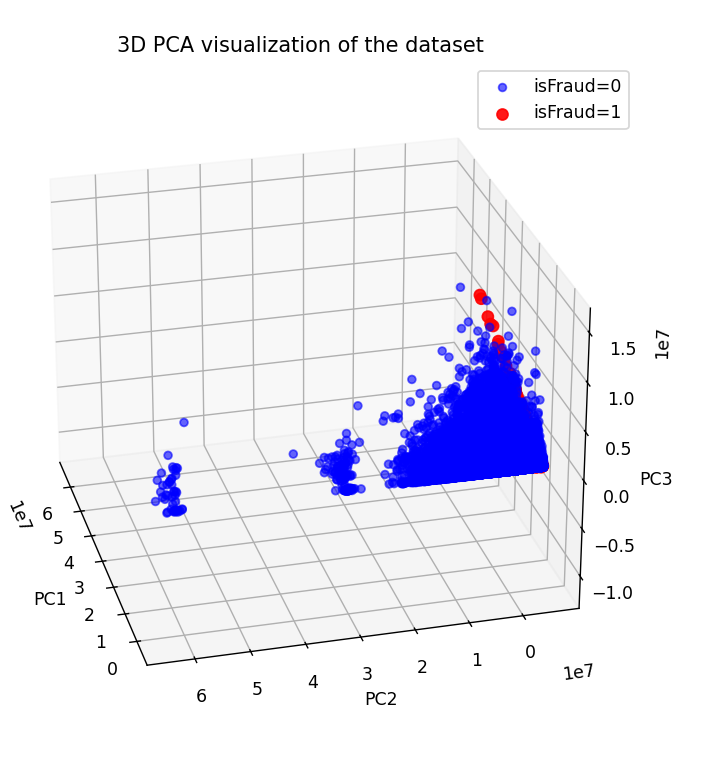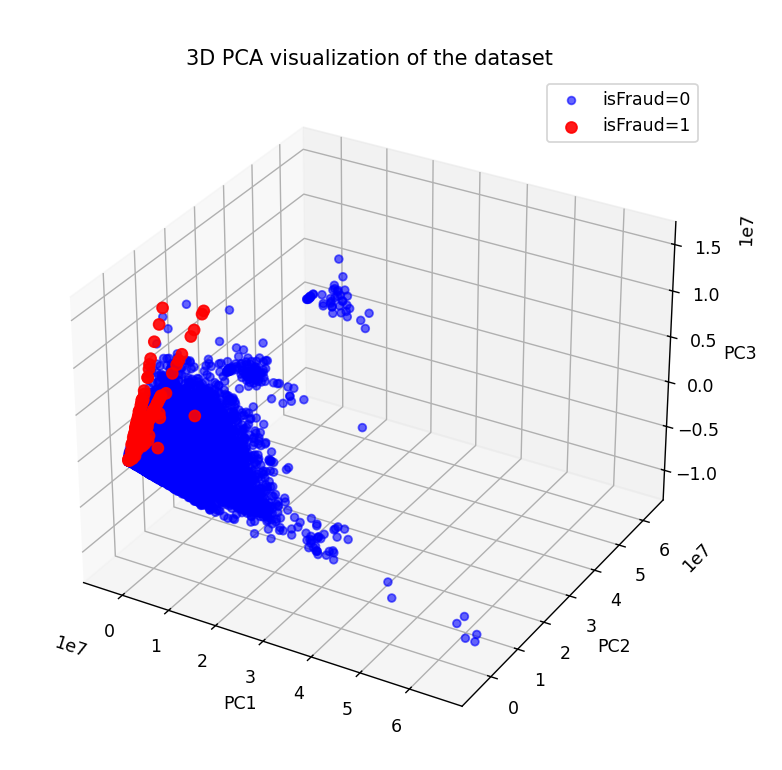

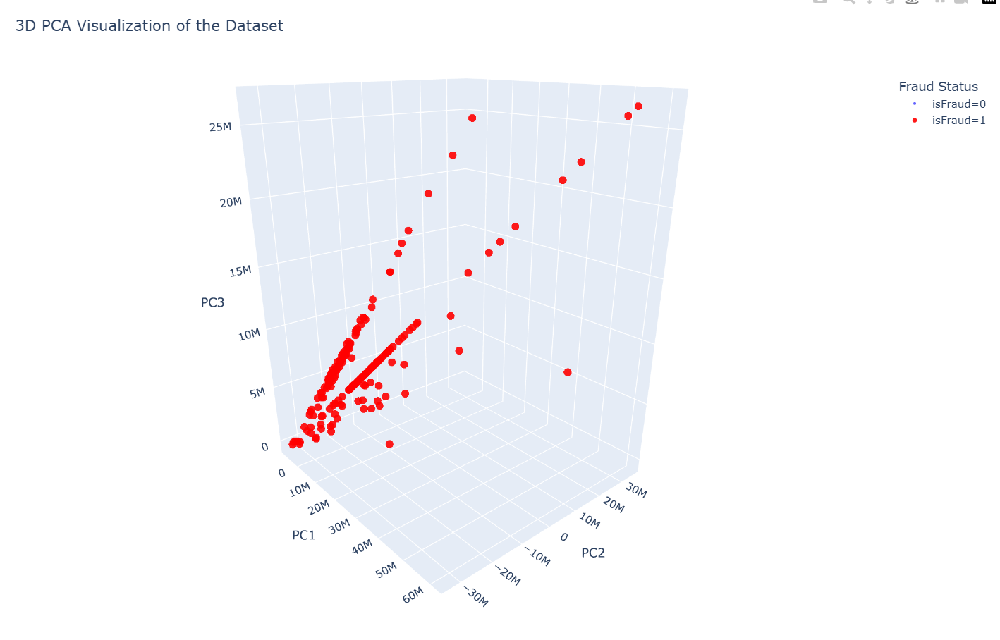

I have made two versions of the PCA graph, one with Matplotlib and another with Plotly. Because both graphs are so slow they are almost nonfunctional, I have embedded screenshots above. The first screenshot displays some clustering, especially along PC2 in nonfraudulent cases.

The second screenshot and the filtered third screenshot show the remarkably linear nature of fraud cases. This is most likely due to the synthetic nature of the dataset, and overfitting will be a concern in the modelling phase.


# Data preprocessing

In [16]:
def grab_col_names(dataframe, cat_th=5, car_th=20):
    # cat_cols, cat_but_car
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "O"]
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique() < cat_th and
                   dataframe[col].dtypes != "O"]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and
                   dataframe[col].dtypes == "O"]
    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    # num_cols
    num_cols = [col for col in dataframe.columns if dataframe[col].dtypes != "O"]
    num_cols = [col for col in num_cols if col not in num_but_cat]

    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f"cat_cols: {len(cat_cols)}")
    print(f"num_cols: {len(num_cols)}")
    print(f"cat_but_car: {len(cat_but_car)}")
    print(f"num_but_car: {len(num_but_cat)}")
    return cat_cols, num_cols, cat_but_car


cat_cols, num_cols, cat_but_car = grab_col_names(df)

Observations: 2372805
Variables: 14
cat_cols: 2
num_cols: 10
cat_but_car: 2
num_but_car: 1


## Missing Values

In [40]:
df.isna().any().any()

False

## Outliers

In [45]:
for col in num_cols:
    if check_outlier(df, col) == True:
        print(f"Column: {col}")
        print("isFraud sum for outliers: ", df.loc[grab_outliers(df, col, True), 'isFraud'].sum() )
        print()
    else:
        print(f"Column: {col} has no outliers.")
        print()

Column: Id has no outliers.

Column: step has no outliers.

Column: amount
Outlier count: 69016
          Id  step    action       amount     nameOrig  oldBalanceOrig  newBalanceOrig     nameDest  oldBalanceDest  newBalanceDest  isFraud  Id_diff  changeOrig  changeDest  origIsMerchant  destIsMerchant
5277    7377     7  TRANSFER 1,071,371.72  C7720489257       18,999.79       18,999.79  C4465106088            7.37            7.37        0     1.00        0.00        0.00               1               0
5639    7891     7  TRANSFER   749,541.77  C5896693522       73,642.69       73,642.69  C6316116359           92.32           92.32        0     1.00        0.00        0.00               1               1
6053    8475     7  TRANSFER   745,519.31  C5352772185      300,899.51      300,899.51  C0799991264           66.15           66.15        0     1.00        0.00        0.00               1               1
6502    9079     7  TRANSFER   670,506.68  C2313831283           63.51          

In [34]:
def outlier_thresholds(dataframe, col_name, q1=0.10, q3=0.90):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    return low_limit, up_limit

def check_outlier(dataframe, col_name):
    low_limit, up_limit = outlier_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name] > up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
        return True
    else:
        return False

def grab_outliers(dataframe, col_name, index=False):
    low, up = outlier_thresholds(dataframe, col_name)
    print("Outlier count:", dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].shape[0])
    if dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].shape[0] > 10:
        print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].head())
    else:
        print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))])

    if index:
        outlier_index = dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].index
        return outlier_index

It is noteworthy that:
- `amount` has 162,
- `newBalanceDest` has 83,
- `changeOrig` has 162,
- `changeDest` has 84,

of the 178 fraud cases as their outliers when outliers are defined as those values below the 10th and above the 90th quantiles.

## Social Network Analysis (SNA)

In [17]:
G = nx.Graph()

orig_degrees = []
dest_degrees = []

for _, row in df.iterrows():
    # Add the edge to the graph
    G.add_edge(row['nameOrig'], row['nameDest'])
    # Compute the current degree of 'nameOrig' and 'nameDest'
    orig_degrees.append(G.degree[row['nameOrig']])
    dest_degrees.append(G.degree[row['nameDest']])

print("Number of nodes:", G.number_of_nodes())
print("Number of edges:", G.number_of_edges())

# Add the degree scores back to the DataFrame
df['orig_degree'] = orig_degrees
df['dest_degree'] = dest_degrees

Number of nodes: 54945
Number of edges: 2261666


## Feature Engineering

### Account features

In [18]:
unique_nameOrig = set(df['nameOrig'].unique())
unique_nameDest = set(df['nameDest'].unique())
common_values = unique_nameOrig.intersection(unique_nameDest)

percent_nameOrig_in_nameDest = (len(common_values) / len(unique_nameOrig)) * 100
percent_nameDest_in_nameOrig = (len(common_values) / len(unique_nameDest)) * 100

print(f"Percentage of unique nameOrig values present in nameDest: {percent_nameOrig_in_nameDest:.2f}%")
print(f"Percentage of unique nameDest values present in nameOrig: {percent_nameDest_in_nameOrig:.2f}%")

df['nameOrigInCommon'] = df['nameOrig'].isin(common_values).astype(int)
df['nameDestInCommon'] = df['nameDest'].isin(common_values).astype(int)

print(df.groupby("nameOrigInCommon")["isFraud"].mean())
print(df.groupby("nameDestInCommon")["isFraud"].mean())

Percentage of unique nameOrig values present in nameDest: 99.71%
Percentage of unique nameDest values present in nameOrig: 25.68%
nameOrigInCommon
0   0.01
1   0.00
Name: isFraud, dtype: float64
nameDestInCommon
0   0.00
1   0.00
Name: isFraud, dtype: float64


### Balance features

In [21]:
df.loc[(df["newBalanceOrig"] > df["oldBalanceOrig"]), 'changeBalanceOrig'] = 1
df.loc[(df["newBalanceOrig"] == df["oldBalanceOrig"]), 'changeBalanceOrig'] = 0
df.loc[(df["newBalanceOrig"] < df["oldBalanceOrig"]), 'changeBalanceOrig'] = -1
df.loc[(df["newBalanceDest"] > df["oldBalanceDest"]), 'changeBalanceDest'] = 1
df.loc[(df["newBalanceDest"] == df["oldBalanceDest"]), 'changeBalanceDest'] = 0
df.loc[(df["newBalanceDest"] < df["oldBalanceDest"]), 'changeBalanceDest'] = -1

# any(df["newBalanceDest"] < df["oldBalanceDest"]) # False
#
# df[df["changeBalanceDest"] == 1].groupby("action")["action"].count()
# action
# PAYMENT     549563
# TRANSFER    132475

# df[df["action"] == "TRANSFER"].groupby("isFraud")["changeBalanceDest"].mean()
# Out[66]:
# isFraud
# 0   0.95
# 1   1.00

# Bunlar customer-level olduğu için commentledim
# df['totalTransactionCount'] = df.groupby('nameOrig')['step'].transform('count')
# df['transactionsFreqDailyAvg'] = df['total_transaction_count']/30

# Detect unusual transaction size with this:
df['averageTransactionAmount'] = df.groupby('nameOrig')['amount'].transform("mean")
df['transactionAmountRatio'] = df['amount'] / (df['averageTransactionAmount'] + 1e-9)
#df['relative_transaction_size'] = df['amount'] / np.log(df['oldBalanceOrig'].replace(0, 1e-6))
# df['amountRelativeToOldBalanceOrig'] = df['amount'] / (df['oldBalanceOrig'] + 1e-9)
# TODO which one?
# TODO I commented out one of them because the log was creating problems for some reason but it normalizes so it may be better.

# TODO burada ne oluyor?
# df[df["action"] == "CASH_IN"]["changeBalanceDest"].mean() # 0.0
# TODO yani dışarıdan para giriyor galiba ve dolayısıyla balanceDest etkilenmiyor.
# e peki bu durumda balancedest ne ki?

# df[df["action"] == "CASH_IN"]["newBalanceDest"].describe()
# Out[29]:
# count   1,032,064.00
# mean       73,748.11
# std        67,471.75
# min             0.00
# 25%        10,986.35
# 50%        60,373.00
# 75%       121,432.52
# max       411,339.42
# df.loc[(df["action"] == "CASH_IN") & (df["newBalanceDest"] == 411339.42)]
# Out[48]:
#               Id  step   action    amount     nameOrig  oldBalanceOrig  newBalanceOrig     nameDest  oldBalanceDest  newBalanceDest  isFraud  isFlaggedFraud
# 2272545  3211425   358  CASH_IN 96,583.38  C9189415629    3,169,959.26    3,266,542.64  C6835356850      411,339.42      411,339.42        0               0

### Time features

In [22]:
df['hourOfDay'] = (df['step'] % 24).astype(int)
df['dayOfWeek'] = ((df['step'] // 24) % 7 + 1).astype(int)
df['dayOfMonth'] = ((df['step'] // 24) % 30 + 1).astype(int)
df['weekOfMonth'] = ((df['step'] // 24) // 7 + 1).astype(int)

time_features = ['hourOfDay', 'dayOfWeek', 'dayOfMonth', 'weekOfMonth']
correlations = {feature: df[[feature, 'isFraud']].corr().iloc[0, 1] for feature in time_features}
print("Correlations with isFraud:")
print(correlations)

Correlations with isFraud:
{'hourOfDay': -0.00805744822592384, 'dayOfWeek': 0.002369110313568632, 'dayOfMonth': 0.012962767219116595, 'weekOfMonth': 0.012813534837103078}


The low correlation between the time features and the `isFraud` variable is good.

Now, let's draw histograms for fraudulent transaction times:

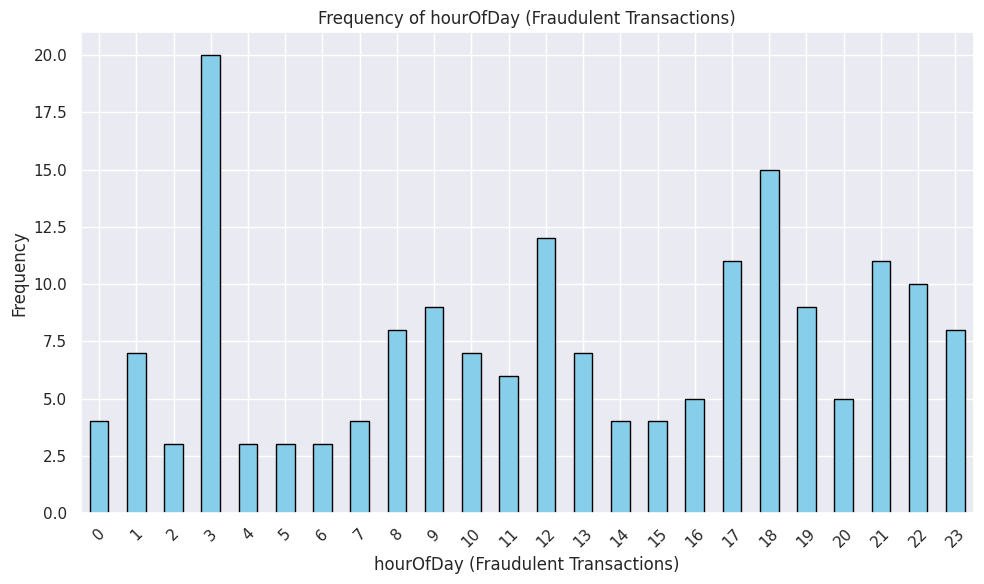

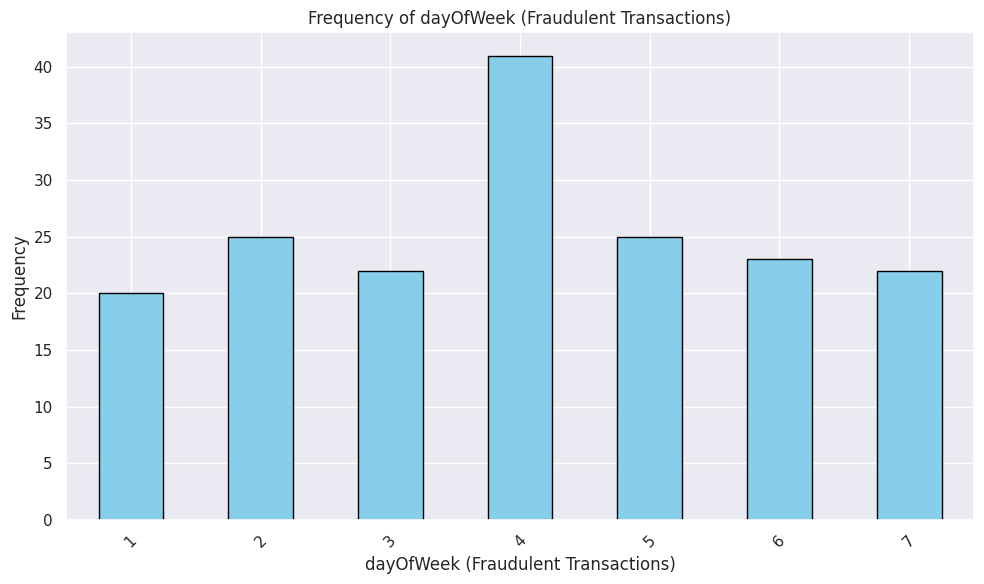

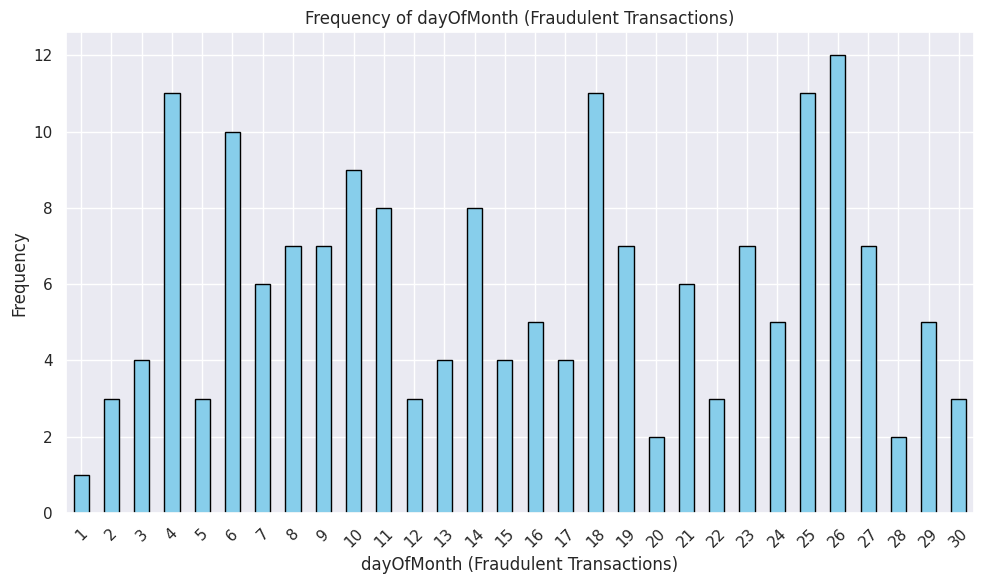

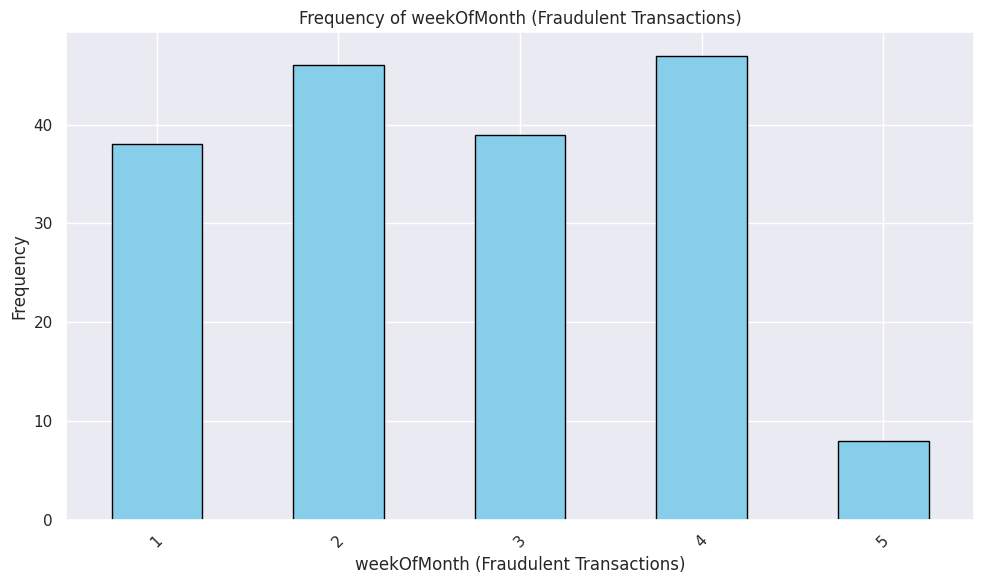

In [ ]:
def create_histogram(dataframe, col, fraud=False):
    if fraud == True:
        dataframe = dataframe[dataframe["isFraud"] == 1].copy()
        fraud_label = "Fraudulent Transactions"
    else:
        fraud_label = "All Transactions"
    counts = dataframe[col].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    counts.plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Frequency of {col} ({fraud_label})')
    plt.xlabel(f'{col} ({fraud_label})')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

for col in time_features:
    create_histogram(df, col, True)

## Correlation Analysis

Observations: 2372805
Variables: 26
cat_cols: 6
num_cols: 18
cat_but_car: 2
num_but_car: 5


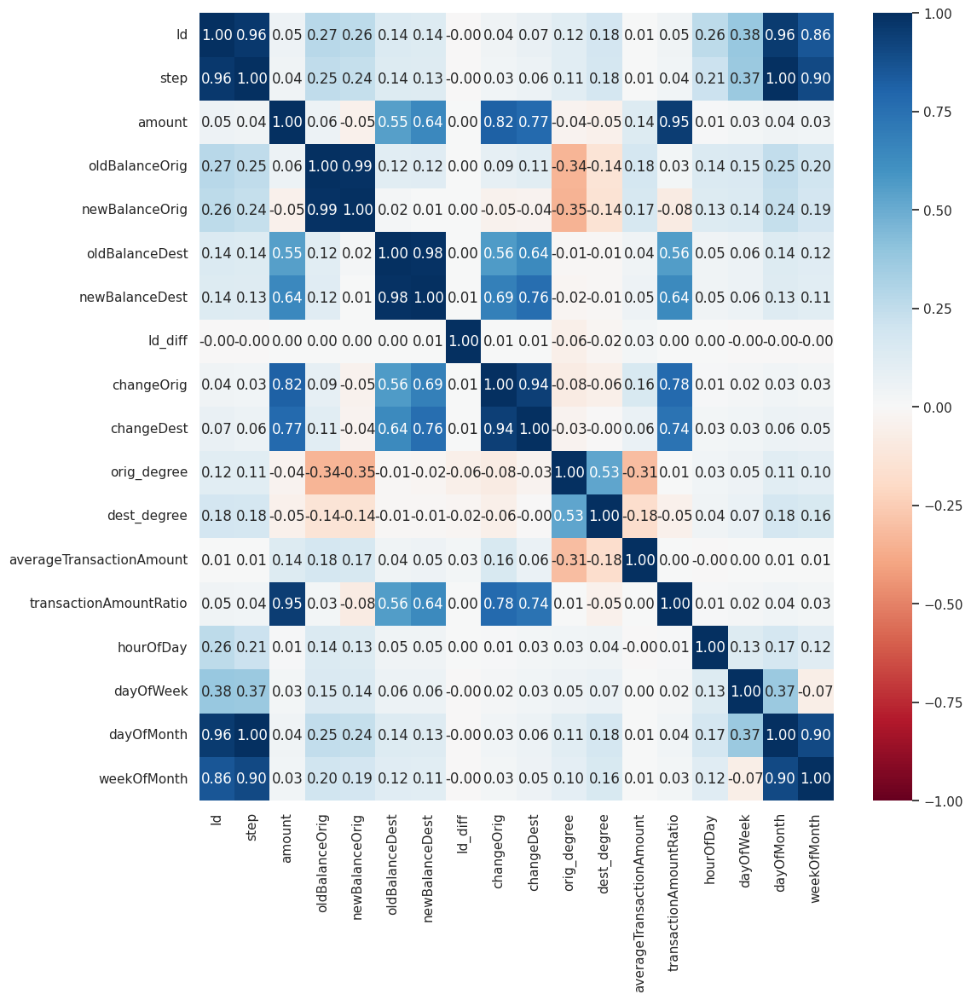

['step',
 'newBalanceOrig',
 'newBalanceDest',
 'changeDest',
 'transactionAmountRatio',
 'dayOfMonth',
 'weekOfMonth']

In [24]:
cat_cols, num_cols, cat_but_car = grab_col_names(df)

corr = df[num_cols].corr()

def high_correlated_cols(dataframe, plot=False, corr_th=0.90):
    corr = dataframe[num_cols].corr()
    cor_matrix = corr.abs()
    upper_triangle_matrix = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))
    drop_list = [col for col in upper_triangle_matrix if any(upper_triangle_matrix[col] > corr_th)]
    if plot:
        sns.set(rc={'figure.figsize': (12, 12)})
        sns.heatmap(corr, cmap='RdBu', annot=True, vmin=-1, vmax=1, fmt=".2f")
        plt.show()
    return drop_list

drop_list = high_correlated_cols(df, plot=True)
drop_list

In [26]:
# newBalanceOrig was high on the feature importance list, so let's keep it
drop_list.append('oldBalanceOrig')
drop_list.remove('newBalanceOrig')
df.drop(drop_list, axis=1, inplace=True)

## Encoding

Let's first check datatypes and separate columns by datatype:

In [28]:
print(df.dtypes)
cat_cols, num_cols, cat_but_car = grab_col_names(df)

Id                            int64
action                       object
amount                      float64
nameOrig                     object
newBalanceOrig              float64
nameDest                     object
oldBalanceDest              float64
isFraud                       int64
Id_diff                     float64
changeOrig                  float64
orig_degree                   int64
dest_degree                   int64
nameOrigInCommon              int64
nameDestInCommon              int64
changeBalanceOrig           float64
changeBalanceDest           float64
averageTransactionAmount    float64
hourOfDay                     int64
dayOfWeek                     int64
dtype: object
Observations: 2372805
Variables: 19
cat_cols: 6
num_cols: 11
cat_but_car: 2
num_but_car: 5


### Numerical columns

Now we can ensure the numerical columns are actually numerical, and binary columns are actually binary.

In [29]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int, float]
               and df[col].nunique() == 2]

labelencoder = LabelEncoder()
for col in binary_cols:
    df[col] = labelencoder.fit_transform(df[col])

### Categorical columns

Relational encoding preserves the relationships between the nodes in the social network. As I have created the `orig_degree` and `dest_degree` variables previously, we can drop the `nameOrig` and  `nameDest` variables.

In [30]:
df.drop(["nameOrig", "nameDest"], axis=1, inplace=True)

One-hot encoding for the rest of the categorical columns:

In [32]:
ohe_cols = [col for col in df.columns if 5 >= df[col].nunique() > 2]
ohe_cols = [col for col in ohe_cols if 'hourOfDay' not in col]
print(ohe_cols)

df = pd.get_dummies(df, columns=ohe_cols, drop_first=True, dtype=int)

['action', 'changeBalanceOrig']


## Scaling

There are many outliers that may decrease the level of information retained after scaling. So let's check them again and decide if we want to trim them, winsorize them, or keep them:

In [35]:
cat_cols, num_cols, cat_but_car = grab_col_names(df, 5)

outlier_cols = []
print()
for col in num_cols:
    print(col, check_outlier(df, col))
    if check_outlier(df, col):
        outlier_cols.append(col)

# for col in outlier_cols:
#     num_summary(df, col)


# df[df["amount"] > 14000000]["isFraud"].sum() # 0
# df[df["amount"] > 14000000]["amount"].count()
# df.loc[df['amount'] > 14000000, 'amount'] = 14000000

# df[df["oldBalanceOrig"] > 13500000]["isFraud"].sum() # 0
# df[df["oldBalanceOrig"] > 13500000]["oldBalanceOrig"].count()
# df.loc[df['oldBalanceOrig'] > 13500000, 'oldBalanceOrig'] = 13500000

# df[df["oldBalanceDest"] > 3500000]["isFraud"].sum() # 0
# df[df["oldBalanceDest"] > 3500000]["oldBalanceDest"].count()
# df.loc[df['oldBalanceDest'] > 3500000, 'oldBalanceDest'] = 3500000

# df[df["changeOrig"] > 13000000]["isFraud"].sum() # 1

# df[df["nameOrigDegree"] > 800]["isFraud"].sum() # 0
# df[df["nameOrigDegree"] > 800]["nameOrigDegree"].count()
# df.loc[df['nameOrigDegree'] > 800, 'nameOrigDegree'] = 800

# df[df["nameDestDegree"] > 100]["isFraud"].sum() # 0
# df[df["nameDestDegree"] > 100]["nameDestDegree"].count()
# df.loc[df['nameDestDegree'] > 100, 'nameDestDegree'] = 100


rs = RobustScaler()
for col in num_cols:
    df[col] = rs.fit_transform(df[[col]])

df.describe()

Observations: 2372805
Variables: 21
cat_cols: 10
num_cols: 11
cat_but_car: 0
num_but_car: 10

Id False
amount True
newBalanceOrig True
oldBalanceDest True
Id_diff True
changeOrig True
orig_degree True
dest_degree True
averageTransactionAmount True
hourOfDay False
dayOfWeek False


,Id,amount,newBalanceOrig,oldBalanceDest,isFraud,Id_diff,changeOrig,orig_degree,dest_degree,nameOrigInCommon,nameDestInCommon,changeBalanceDest,averageTransactionAmount,hourOfDay,dayOfWeek,action_CASH_OUT,action_DEBIT,action_PAYMENT,action_TRANSFER,changeBalanceOrig_0.0,changeBalanceOrig_1.0
count,"2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00","2,372,805.00"
mean,-0.00,0.30,-0.06,1.72,0.00,0.41,0.27,4.08,1.26,1.00,0.04,0.29,0.03,-0.30,0.08,0.24,0.04,0.23,0.06,0.01,0.43
std,0.58,1.99,1.14,7.99,0.01,1.48,1.66,19.78,7.16,0.03,0.20,0.45,1.63,0.85,0.45,0.42,0.19,0.42,0.24,0.12,0.50
min,-1.00,-0.62,-2.36,-1.85,0.00,-1.00,-0.61,-0.61,-0.94,0.00,0.00,0.00,-5.49,-3.17,-0.40,0.00,0.00,0.00,0.00,0.00,0.00
25%,-0.50,-0.53,-0.55,-0.46,0.00,0.00,-0.53,-0.36,-0.48,1.00,0.00,0.00,-0.50,-0.67,-0.40,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.50,0.47,0.45,0.54,0.00,0.00,0.47,0.64,0.52,1.00,0.00,1.00,0.50,0.33,0.60,0.00,0.00,0.00,0.00,0.00,1.00
max,1.00,128.44,29.69,399.30,1.00,47.00,83.40,143.76,899.21,1.00,1.00,1.00,493.37,0.67,0.80,1.00,1.00,1.00,1.00,1.00,1.00


After taking a closer look into the relationship between outliers above or below specific outlier thresholds and their relationship with fraud, I decided to leave them as they are.

# Modelling

When I first ran the models on `df` as it is at this point of the notebook, the success metrics were so high I was sure it was overfitting. And so I experimented with different dataframes: Filtered, oversampled, and both. The winning combo is:
1. Filtered down to `CASH_OUT` and `TRANSFER` categories of the `action` variable, and
2. Over-sampled using SMOTE.

<br>

The reasoning for the filtering step is that the data appears to be trivially separable along the `action` categories: `CASH_IN`, `PAYMENT`, and `DEBIT` contain only non-fraudulent transactions, and so the model can easily learn that if a transaction belongs to any of these categories, it is not fraudulent. Meanwhile, `CASH_OUT` and `TRANSFER` contain both fraudulent and non-fraudulent transactions. While fraud is rare in these categories, the model still needs to distinguish between the two.


<br>

> In fraud detection, fraud patterns evolve over time. If the data is trivially separable based on current patterns, future fraud cases (or rare fraud cases in the present) may be missed. However, this dataset is synthetic, and as can be seen in PCA, the fraud cases are almost perfectly linearly arranged. This explains the high success metrics in all different iterations of most models (including all of the supervised ones).






In [36]:
mask = (df['action_CASH_OUT'] == 1) | (df['action_TRANSFER'] == 1)
df_filtered = df[mask].copy()
df_filtered.drop(columns=['action_CASH_OUT', 'action_DEBIT', 'action_PAYMENT'], axis=1, inplace=True)

X = df_filtered.drop(["isFraud"], axis=1)
y = df_filtered["isFraud"]

In [38]:
df_filtered.shape

(699523, 18)

## Over Sampling with SMOTE


Using Synthetic Minority Over-sampling Technique (SMOTE), I over sample X and y so the minority fraud class becomes 1% of the whole dataset.

<br>

**I chose SMOTE over Random Over-sampling as it:**
- Avoids data duplication:
  - Random over-sampling duplicates minority samples, increasing the risk of overfitting, as the model may memorize these duplicates instead of generalizing patterns.
  - SMOTE generates synthetic samples by interpolating between minority class samples, which introduces new data points and reduces overfitting.

- Preserves model robustness as its synthetically generated samples effectively increase the diversity of the training data, helping the model learn better generalization.

<br>

**I chose SMOTE over ADASYN because:**
- SMOTE gives equal importance to all samples in the minority class when generating synthetic data.
  - ADASYN focuses more on harder-to-classify regions of the minority class by adaptively generating more samples in those regions. This can lead to overemphasis on noisy or borderline points, which may reduce model performance for highly imbalanced datasets like fraud detection.
- ADASYN can introduce instability when the minority class data has significant outliers or irregular distributions.

In [39]:
smote = SMOTE(k_neighbors=2, sampling_strategy=0.01, random_state=42)
X_smote, y_smote = smote.fit_resample(X, y)
print('X_smote, y_smote:', sorted(Counter(y_smote).items()))

print("X_smote shape:", X_smote.shape)
print("y_smote shape:", y_smote.shape)

X_smote, y_smote: [(0, 699345), (1, 6993)]
X_smote shape: (706338, 17)
y_smote shape: (706338,)


## Model

In [40]:
# Set up logging to log the output
logging.basicConfig(filename='model_performance.log', level=logging.INFO)

def log_results(model_name, report, log_dir="/content/drive/My Drive/logs"):
    # Ensure log directory exists
    os.makedirs(log_dir, exist_ok=True)

    # Save log to file
    file_path = os.path.join(log_dir, f"{model_name}_report.json")
    with open(file_path, "w") as file:
        json.dump(report, file, indent=4)

    # Log to the logging system
    logging.info(f"Saved log for {model_name} to {file_path}")
    logging.info(f"{model_name} Classification Report:\n{report}")


-- Logistic Regression (Balanced): Training and Evaluating Logistic Regression (Balanced) with Time-Aware CV...
Fold 0...


/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



Fold 1...
Fold 2...
Fold 3...
Fold 4...
Average Classification Report for Logistic Regression (Balanced):
{'0': {'precision': 0.9997011080776502, 'recall': 0.9907413334279778, 'f1-score': 0.9951997478230658, 'support': 116343.4}, '1': {'precision': 0.49601918217897045, 'recall': 0.9680746028887326, 'f1-score': 0.6435426280074794, 'support': 1379.6}, 'macro avg': {'precision': 0.7478601451283102, 'recall': 0.9794079681583551, 'f1-score': 0.8193711879152726, 'support': 117723.0}, 'weighted avg': {'precision': 0.9951334712893247, 'recall': 0.9905557962335312, 'f1-score': 0.992154206255291, 'support': 117723.0}, 'accuracy': 0.9905557962335312}

Error with Logistic Regression (Balanced): [Errno 2] No such file or directory: '/content/drive/My Drive/model_outputs/Logistic Regression (Balanced)_confusion_matrix_1.png'

-- Random Forest (Balanced Subsample): Training and Evaluating Random Forest (Balanced Subsample) with Time-Aware CV...
Fold 0...
Fold 1...
Fold 2...
Fold 3...
Fold 4...
Averag

/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



Fold 1...
Fold 2...
Fold 3...
Fold 4...
Average Classification Report for Easy Ensemble:
{'0': {'precision': 0.999860966880938, 'recall': 0.9967142056291536, 'f1-score': 0.9982820002111277, 'support': 116343.4}, '1': {'precision': 0.7425773953917835, 'recall': 0.9784574468085105, 'f1-score': 0.8287155989848337, 'support': 1379.6}, 'macro avg': {'precision': 0.8712191811363607, 'recall': 0.9875858262188322, 'f1-score': 0.9134987995979806, 'support': 117723.0}, 'weighted avg': {'precision': 0.9980737178976209, 'recall': 0.9966004943808772, 'f1-score': 0.9971028519731864, 'support': 117723.0}, 'accuracy': 0.9966004943808772}

Error with Easy Ensemble: [Errno 2] No such file or directory: '/content/drive/My Drive/model_outputs/Easy Ensemble_confusion_matrix_1.png'

-- Balanced Bagging (SMOTE): Training and Evaluating Balanced Bagging (SMOTE) with Time-Aware CV...
Fold 0...
Fold 1...
Fold 2...
Fold 3...
Fold 4...
Average Classification Report for Balanced Bagging (SMOTE):
{'0': {'precision'

({'Logistic Regression (Balanced)': {'0': {'precision': 0.9997011080776502,
    'recall': 0.9907413334279778,
    'f1-score': 0.9951997478230658,
    'support': 116343.4},
   '1': {'precision': 0.49601918217897045,
    'recall': 0.9680746028887326,
    'f1-score': 0.6435426280074794,
    'support': 1379.6},
   'macro avg': {'precision': 0.7478601451283102,
    'recall': 0.9794079681583551,
    'f1-score': 0.8193711879152726,
    'support': 117723.0},
   'weighted avg': {'precision': 0.9951334712893247,
    'recall': 0.9905557962335312,
    'f1-score': 0.992154206255291,
    'support': 117723.0},
   'accuracy': 0.9905557962335312},
  'Random Forest (Balanced Subsample)': {'0': {'precision': 0.9969675981955428,
    'recall': 0.9999948592796137,
    'f1-score': 0.9984780194337087,
    'support': 116343.4},
   '1': {'precision': 0.9992465049486828,
    'recall': 0.6996623691844611,
    'f1-score': 0.8083861351136117,
    'support': 1379.6},
   'macro avg': {'precision': 0.9981070515721129,

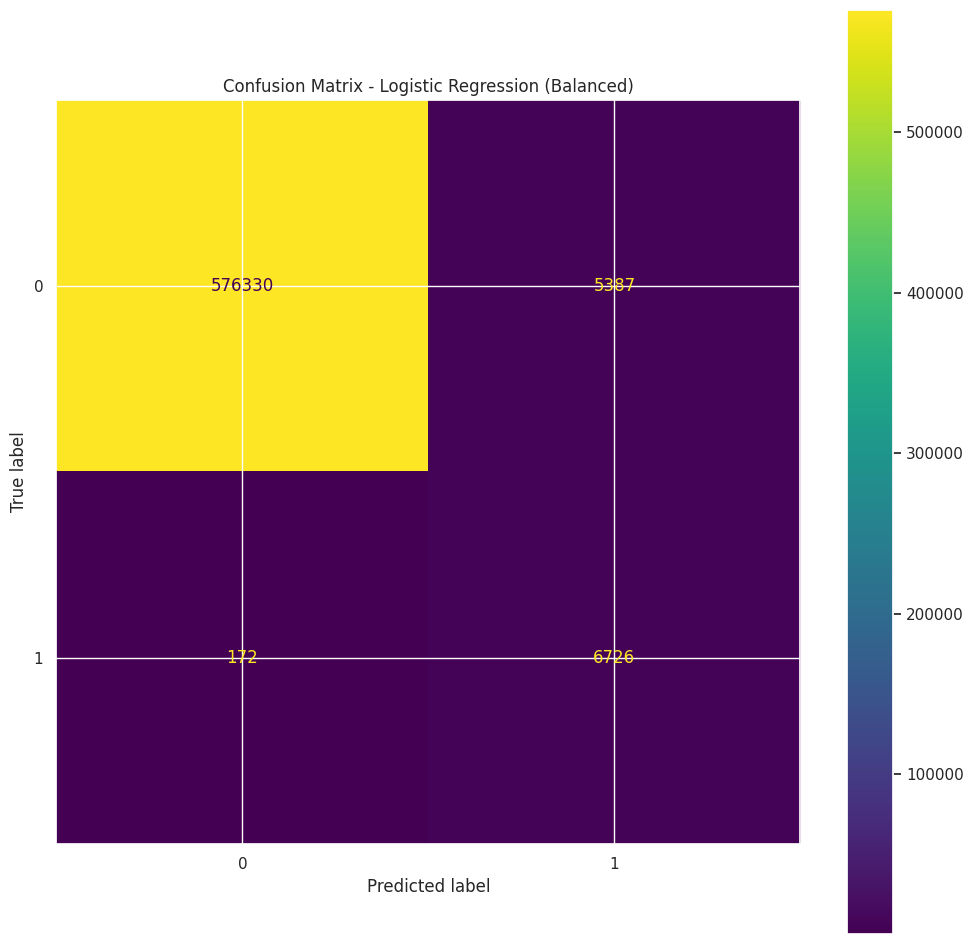

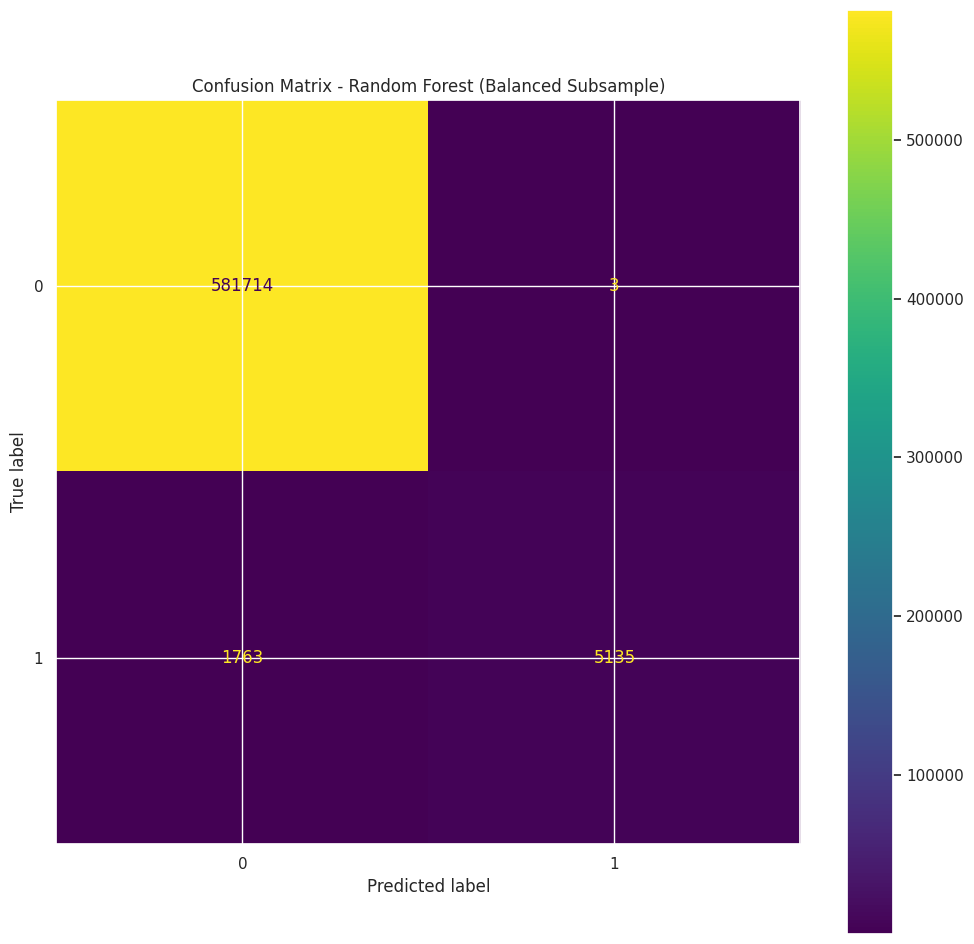

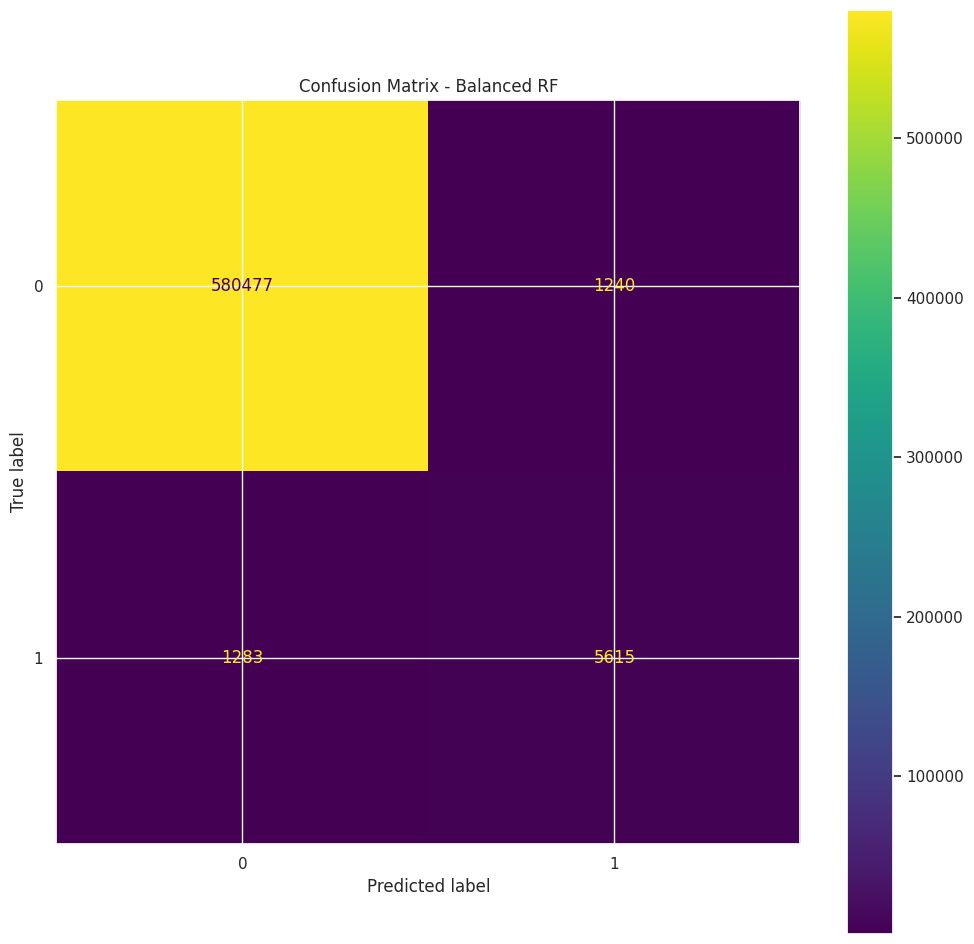

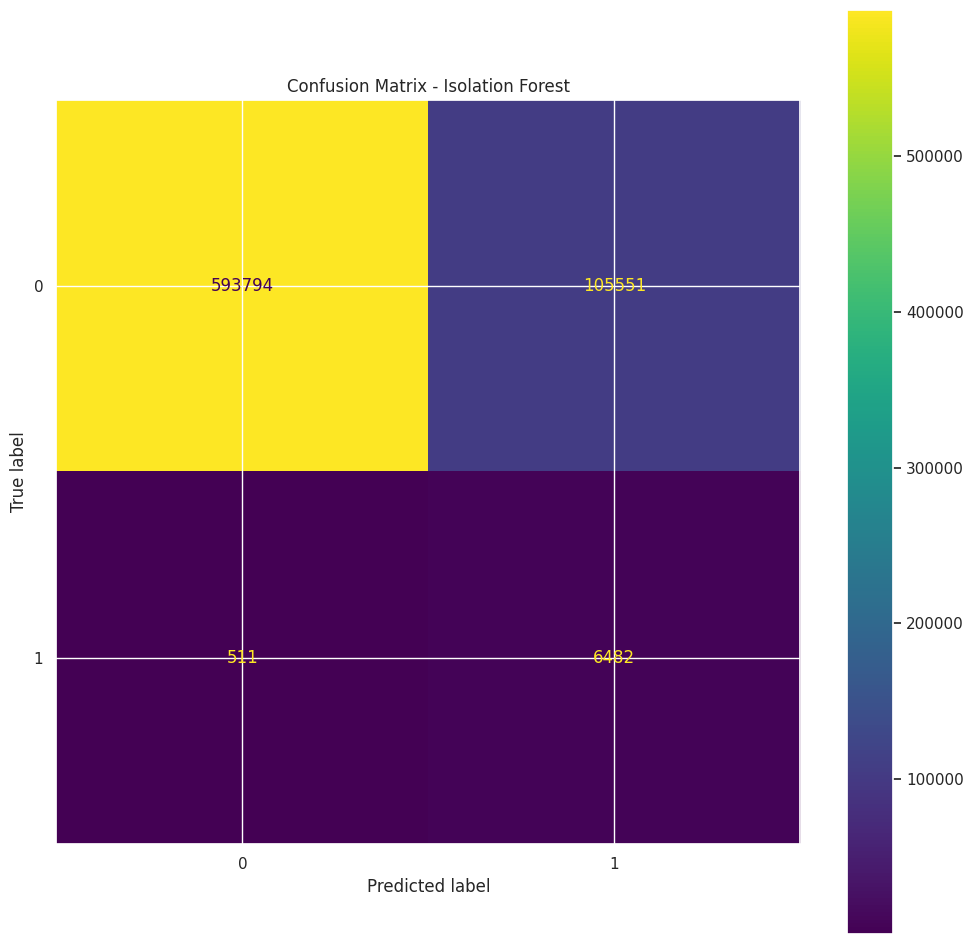

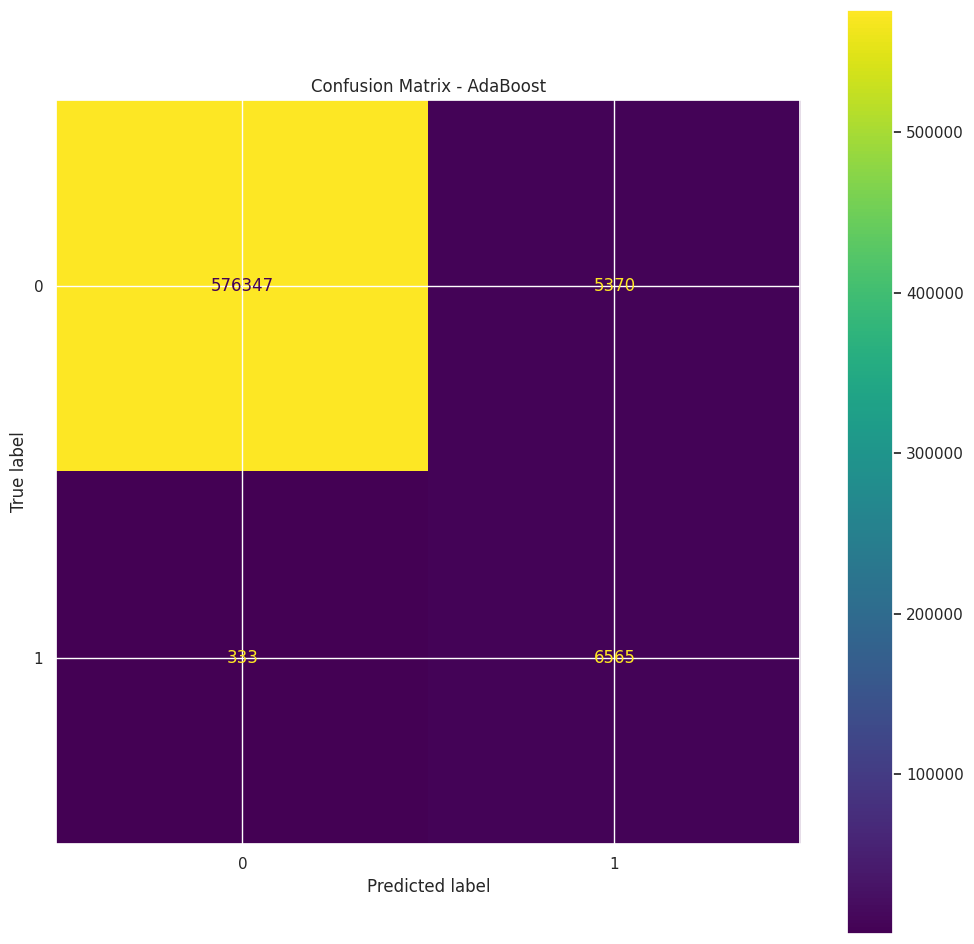

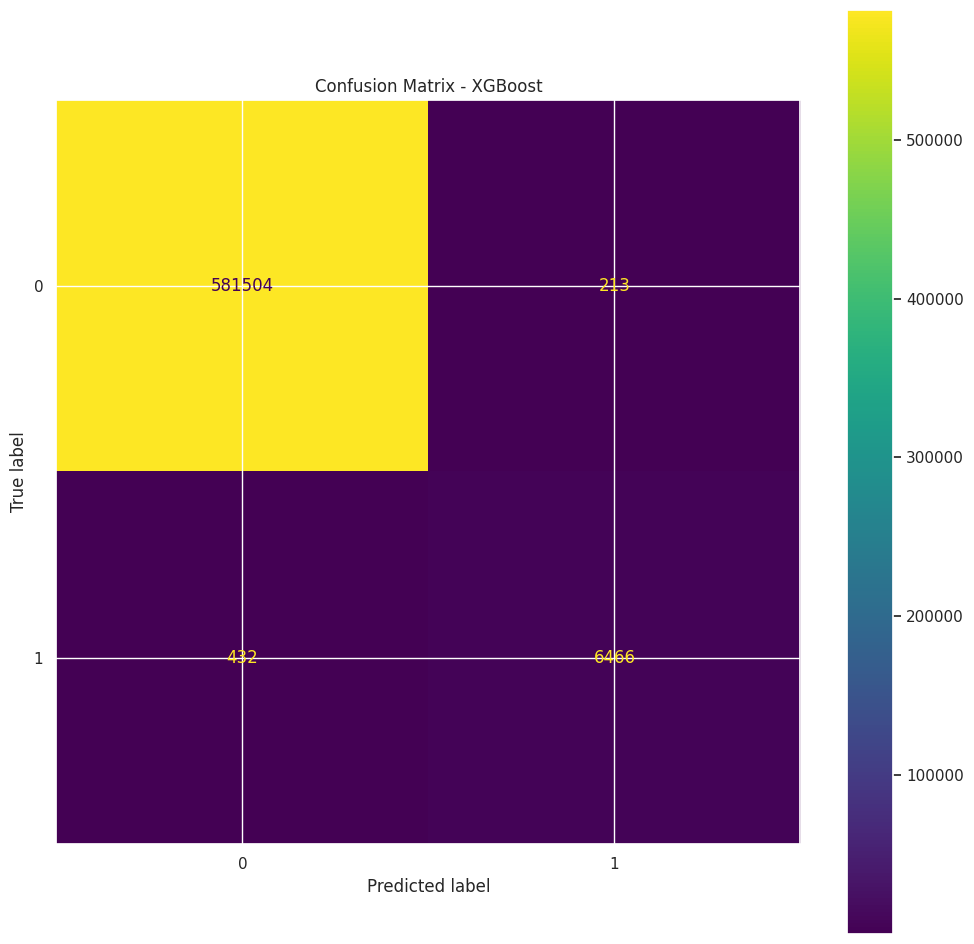

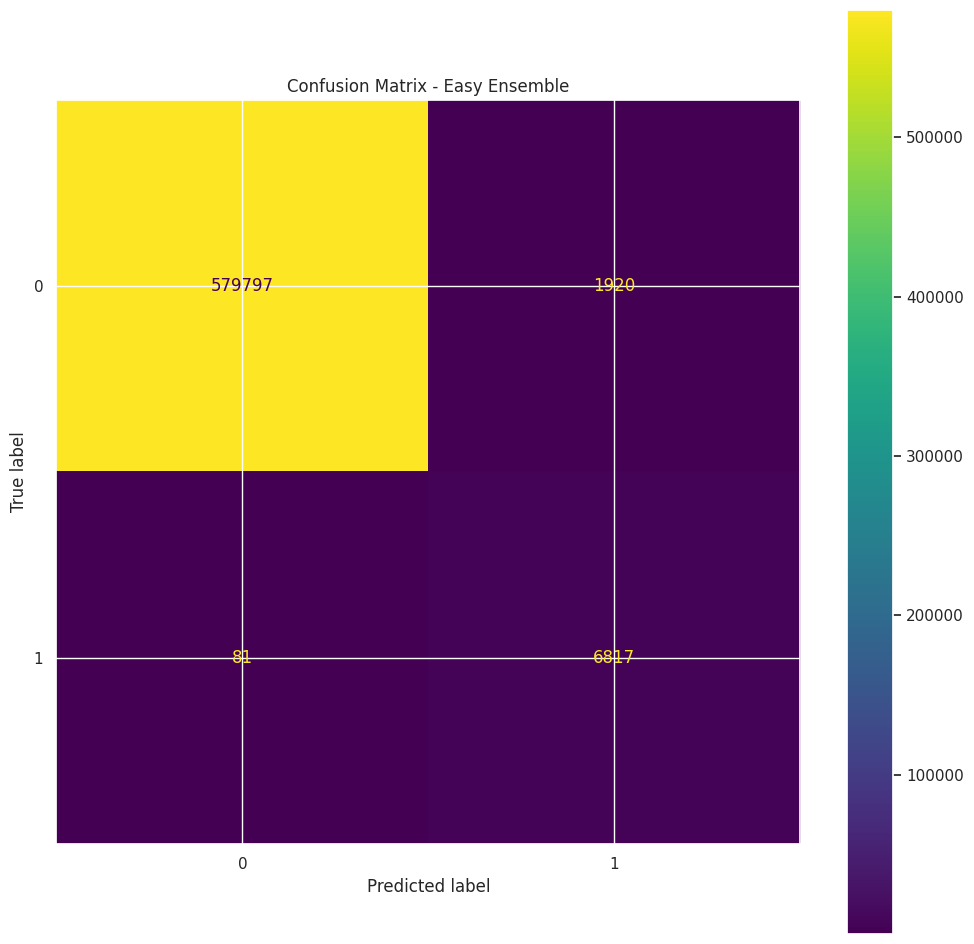

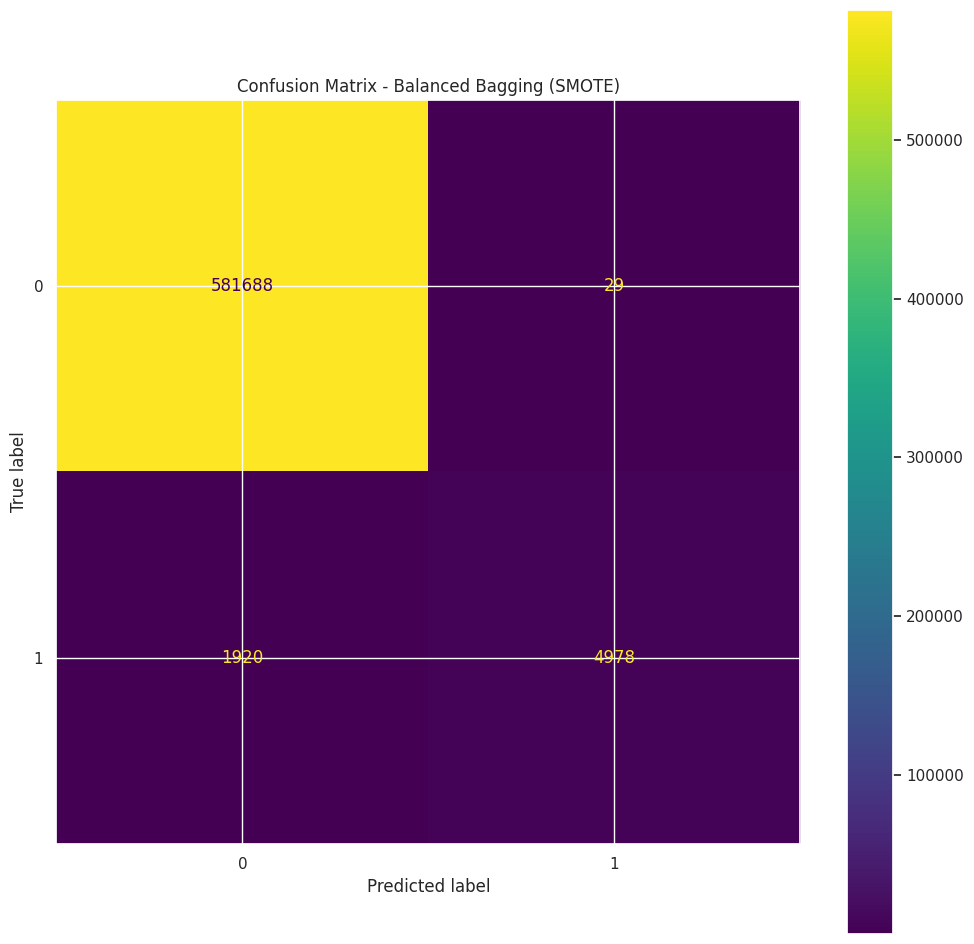

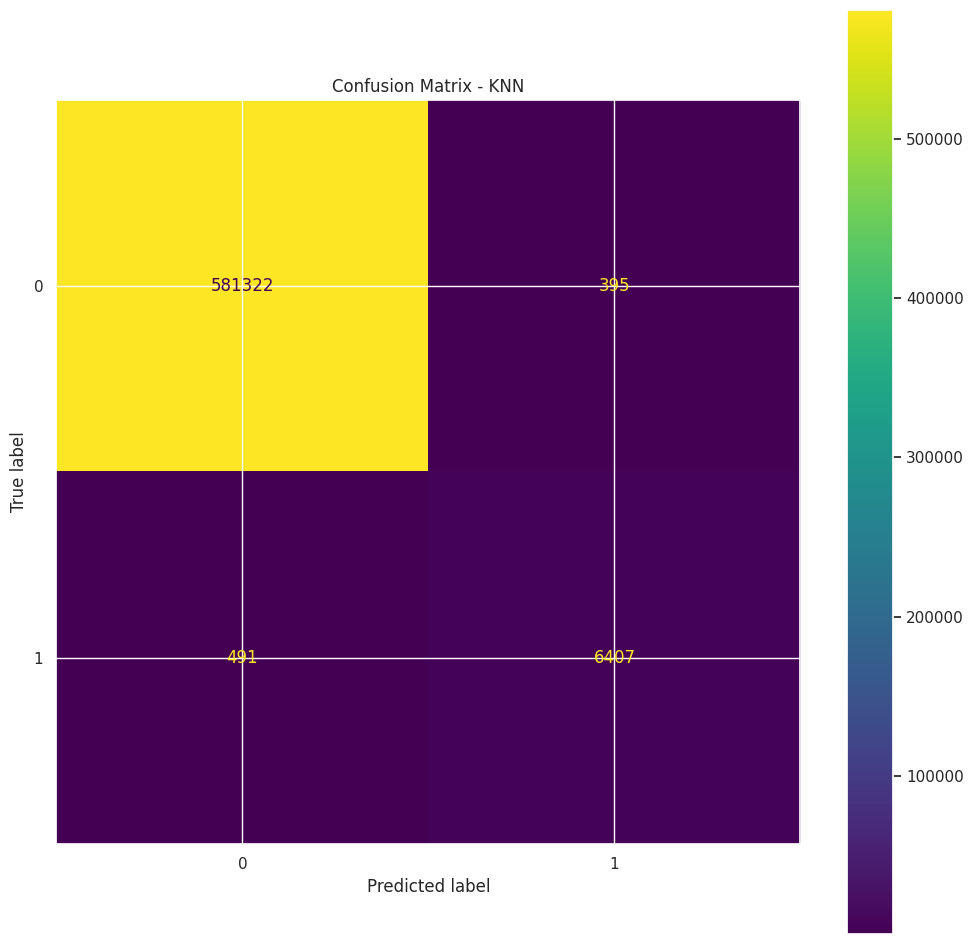

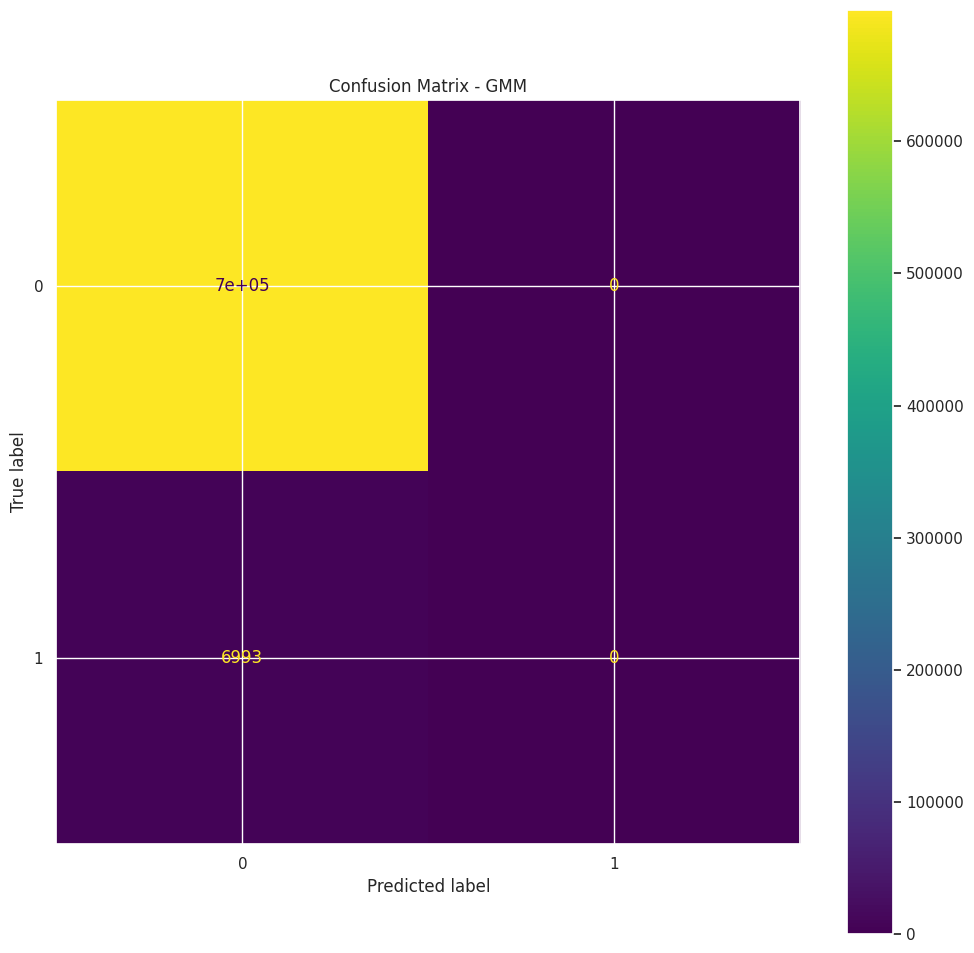

In [41]:
def anomaly_and_ensemble_models_cv(X, y, version='0'):
    # Create directory for saving images if not exists
    os.makedirs(f"/content/drive/My Drive/model_outputs_{version}", exist_ok=True)

    # Sort by time (step)
    # Ensure ascending order so earlier steps come first
    sort_idx = X['Id'].argsort()
    X = X.iloc[sort_idx].reset_index(drop=True)
    y = y.iloc[sort_idx].reset_index(drop=True)

    classifiers = [
        ('Logistic Regression (Balanced)',
         LogisticRegression(class_weight='balanced', random_state=0, n_jobs=-1, max_iter=1000)),
        ('Random Forest (Balanced Subsample)',
         RandomForestClassifier(random_state=42, n_jobs=-1, class_weight='balanced_subsample')),
        ('Balanced RF', BalancedRandomForestClassifier(random_state=42, n_jobs=-1, class_weight='balanced')),
        ('Isolation Forest', IsolationForest(random_state=42, n_jobs=-1)),
        ('AdaBoost', AdaBoostClassifier(random_state=42)),
        ('XGBoost', XGBClassifier(eval_metric='aucpr', n_jobs=-1, scale_pos_weight=1)),
        ('Easy Ensemble', EasyEnsembleClassifier(random_state=42, n_jobs=-1)),
        #('Balanced Bagging (NearMiss)', BalancedBaggingClassifier(random_state=42, n_jobs=-1, sampler=NearMiss(version=3))),
        ('Balanced Bagging (SMOTE)', BalancedBaggingClassifier(random_state=42, n_jobs=-1, sampler=SMOTE())),
        ('KNN', KNeighborsClassifier(n_neighbors=3, n_jobs=-1)),
        ('GMM', GaussianMixture(n_components=2, covariance_type='full', random_state=42, n_init=10)),
    ]

    # Time-aware splitting
    # Note: TimeSeriesSplit does not stratify.
    tscv = TimeSeriesSplit(n_splits=5)

    reports = {}
    confusion_matrices = {}
    feature_importances = {}
    aucpr_curves = {}
    feature_names = X.columns if hasattr(X, 'columns') else [f"feature_{i}" for i in range(X.shape[1])]

    for name, classifier in classifiers:
        try:
            if name in ['Isolation Forest', 'GMM']:
                # Unsupervised models do not use SKF
                print(f"\n-- {name}: Training on X...")
                logging.info(f"Training {name}...")
                classifier.fit(X)
                y_pred = classifier.predict(X)
                y_pred = [1 if pred == -1 else 0 for pred in y_pred]

                report = classification_report(y, y_pred, output_dict=True, zero_division=0)
                reports[name] = report
                log_results(name, report)
                print(f"{name} Classification Report:\n{report}\n")

                # Confusion matrix
                cm = confusion_matrix(y, y_pred)
                confusion_matrices[name] = cm
                disp = ConfusionMatrixDisplay(confusion_matrix=cm)
                disp.plot()
                plt.title(f"Confusion Matrix - {name}")
                plt.savefig(f"/content/drive/My Drive/model_outputs/{name}_confusion_matrix_{version}.png")
                plt.close()

                # No feature importance for these models
                feature_importances[name] = None

            else:
                print(f"\n-- {name}: Training and Evaluating {name} with Time-Aware CV...")
                fold_reports = []
                fold_conf_matrices = []
                y_pred_full = []
                y_true_full = []

                for fold, (train_index, val_index) in enumerate(tscv.split(X, y)):
                    print(f'Fold {fold}...')
                    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
                    y_train, y_val = y.iloc[train_index], y.iloc[val_index]

                    classifier.fit(X_train, y_train)
                    y_pred_val = classifier.predict(X_val)
                    y_pred_full.extend(y_pred_val)
                    y_true_full.extend(y_val)

                    fold_report = classification_report(y_val, y_pred_val, output_dict=True, zero_division=0)
                    fold_reports.append({
                        'accuracy': fold_report['accuracy'],
                        '0.precision': fold_report['0']['precision'],
                        '0.recall': fold_report['0']['recall'],
                        '0.f1-score': fold_report['0']['f1-score'],
                        '0.support': fold_report['0']['support'],
                        '1.precision': fold_report['1']['precision'],
                        '1.recall': fold_report['1']['recall'],
                        '1.f1-score': fold_report['1']['f1-score'],
                        '1.support': fold_report['1']['support'],
                        'macro avg.precision': fold_report['macro avg']['precision'],
                        'macro avg.recall': fold_report['macro avg']['recall'],
                        'macro avg.f1-score': fold_report['macro avg']['f1-score'],
                        'macro avg.support': fold_report['macro avg']['support'],
                        'weighted avg.precision': fold_report['weighted avg']['precision'],
                        'weighted avg.recall': fold_report['weighted avg']['recall'],
                        'weighted avg.f1-score': fold_report['weighted avg']['f1-score'],
                        'weighted avg.support': fold_report['weighted avg']['support']
                    })

                    cm = confusion_matrix(y_val, y_pred_val)
                    fold_conf_matrices.append(cm)

                avg_score = pd.DataFrame(fold_reports).mean(axis=0)
                report = {
                    key: {
                        sub_key: avg_score[f"{key}.{sub_key}"]
                        for sub_key in ['precision', 'recall', 'f1-score', 'support']
                        if f"{key}.{sub_key}" in avg_score}
                    for key in ['0', '1', 'macro avg', 'weighted avg']
                    if
                    any(f"{key}.{sub_key}" in avg_score for sub_key in ['precision', 'recall', 'f1-score', 'support'])
                }
                report['accuracy'] = avg_score['accuracy'] if 'accuracy' in avg_score else None
                reports[name] = report
                log_results(name, report)
                print(f"Average Classification Report for {name}:\n{report}\n")

                # Compute confusion matrix and AUCPR for the combined predictions from cross-validation
                cm_full = confusion_matrix(y_true_full, y_pred_full)
                confusion_matrices[name] = cm_full
                disp = ConfusionMatrixDisplay(confusion_matrix=cm_full)
                disp.plot()
                plt.title(f"Confusion Matrix - {name}")
                plt.savefig(f"/content/drive/My Drive/model_outputs/{name}_confusion_matrix_{version}.png")
                plt.close()

                # Precision-Recall Curve (AUCPR)
                precision, recall, _ = precision_recall_curve(y_true_full, y_pred_full)
                aucpr_score = auc(recall, precision)
                aucpr_curves[name] = aucpr_score
                # Plot and save AUCPR graph
                plt.figure()
                plt.plot(recall, precision, label=f'AUCPR: {aucpr_score:.3f}')
                plt.xlabel("Recall")
                plt.ylabel("Precision")
                plt.title(f"Precision-Recall Curve - {name}")
                plt.legend()
                plt.savefig(f"/content/drive/My Drive/model_outputs/{name}_aucpr_{version}.png")
                plt.close()

                # Feature Importance
                if hasattr(classifier, 'feature_importances_'):
                    importances = classifier.feature_importances_
                    feature_importances[name] = dict(zip(feature_names, importances))

                    # Plot top 20 features
                    sorted_idx = np.argsort(importances)[::-1]
                    top_features = sorted_idx[:20]
                    plt.figure(figsize=(10, 6))
                    plt.barh(np.array(feature_names)[top_features][::-1], importances[top_features][::-1])
                    plt.title(f"Feature Importances - {name}")
                    plt.xlabel("Importance")
                    plt.tight_layout()
                    plt.savefig(f"/content/drive/My Drive/model_outputs/{name}_feature_importances_{version}.png")
                    plt.close()

                elif hasattr(classifier, 'coef_'):
                    # For LogisticRegression, take absolute value of coefficients as importance
                    coef = np.abs(classifier.coef_).ravel()
                    feature_importances[name] = dict(zip(feature_names, coef))

                    sorted_idx = np.argsort(coef)[::-1]
                    top_features = sorted_idx[:20]
                    plt.figure(figsize=(10, 6))
                    plt.barh(np.array(feature_names)[top_features][::-1], coef[top_features][::-1])
                    plt.title(f"Feature Importances (|coef|) - {name}")
                    plt.xlabel("Importance")
                    plt.tight_layout()
                    plt.savefig(f"/content/drive/My Drive/model_outputs/{name}_feature_importances_coef_{version}.png")
                    plt.close()

                else:
                    feature_importances[name] = None

        except Exception as e:
            logging.error(f"Error with {name}: {e}")
            print(f"Error with {name}: {e}")

    return reports, confusion_matrices, feature_importances, aucpr_curves


anomaly_and_ensemble_models_cv(X_smote, y_smote, '1')

Because the positive samples are underrepresented, measures such as AUC under ROC or accuracy inflate the numbers. So, I use the AUC under the Precision Recall curve instead as it doesn't take into account True Negatives.

## Success metrics

### 1) SMOTE 1%



Average Classification Report for Logistic Regression (Balanced):
```
{'0': {'precision': 0.9999957832630839, 'recall': 0.9995047683788026, 'f1-score': 0.9997502149422497, 'support': 474525.4},
'1': {'precision': 0.9528138767911611, 'recall': 0.9995785125691781, 'f1-score': 0.9756308832631095, 'support': 4745.2},
'macro avg': {'precision': 0.9764048300271224, 'recall': 0.9995416404739903, 'f1-score': 0.9876905491026797, 'support': 479270.6},
'weighted avg': {'precision': 0.9995286422362544, 'recall': 0.9995054985830143, 'f1-score': 0.9995114130847158, 'support': 479270.6},
'accuracy': 0.9995054985830143}

```
Average Classification Report for Random Forest (Balanced Subsample):
```
{'0': {'precision': 0.9999890418295735, 'recall': 0.9999995785258943, 'f1-score': 0.9999943101410963, 'support': 474525.4},
'1': {'precision': 0.9999578592498946, 'recall': 0.9989041184701264, 'f1-score': 0.9994306221722342, 'support': 4745.2},
'macro avg': {'precision': 0.999973450539734, 'recall': 0.9994518484980104, 'f1-score': 0.9997124661566653, 'support': 479270.6},
'weighted avg': {'precision': 0.9999887330209839, 'recall': 0.999988732875884, 'f1-score': 0.9999887292817796, 'support': 479270.6},
'accuracy': 0.999988732875884}
```
Average Classification Report for Balanced RF:
```
{'0': {'precision': 0.9999953634695041, 'recall': 0.9999237132472688, 'f1-score': 0.9999595370682336, 'support': 474525.4},
'1': {'precision': 0.9924256379033368, 'recall': 0.999536354056902, 'f1-score': 0.9959682390336821, 'support': 4745.2},
'macro avg': {'precision': 0.9962105006864205, 'recall': 0.9997300336520853, 'f1-score': 0.9979638880509579, 'support': 479270.6},
'weighted avg': {'precision': 0.9999204165494412, 'recall': 0.9999198782420524, 'f1-score': 0.9999200198127731, 'support': 479270.6},
'accuracy': 0.9999198782420524}
```
Isolation Forest Classification Report:
```
{'0': {'precision': 0.994207908429279, 'recall': 0.9362971929426749, 'f1-score': 0.964383956511896, 'support': 2372627.0},
'1': {'precision': 0.06659791140452179, 'recall': 0.45452246480654135, 'f1-score': 0.116173721943626, 'support': 23726.0}, 'accuracy': 0.9315271998741421,
'macro avg': {'precision': 0.5304029099169004, 'recall': 0.6954098288746081, 'f1-score': 0.540278839227761, 'support': 2396353.0},
'weighted avg': {'precision': 0.9850237545131366, 'recall': 0.9315271998741421, 'f1-score': 0.9559859300002066, 'support': 2396353.0}}
```
Average Classification Report for AdaBoost:
```
{'0': {'precision': 0.9999839839111507, 'recall': 0.9999776618901628, 'f1-score': 0.9999808228862236, 'support': 474525.4},
'1': {'precision': 0.9977676314661809, 'recall': 0.9983983850634355, 'f1-score': 0.9980828643329364, 'support': 4745.2},
'macro avg': {'precision': 0.9988758076886658, 'recall': 0.999188023476799, 'f1-score': 0.99903184360958, 'support': 479270.6},
'weighted avg': {'precision': 0.999962040039404, 'recall': 0.9999620256302004, 'f1-score': 0.9999620313954773, 'support': 479270.6},
'accuracy': 0.9999620256302004}
```
Average Classification Report for XGBoost:
'accuracy': 0.9999620256302004}
```
{'0': {'precision': 0.9999987355688008, 'recall': 0.9999924134687623, 'f1-score': 0.9999955745056806, 'support': 474525.4},
'1': {'precision': 0.9992419633377857, 'recall': 0.9998735511064278, 'f1-score': 0.9995576264160855, 'support': 4745.2},
'macro avg': {'precision': 0.9996203494532931, 'recall': 0.9999329822875952, 'f1-score': 0.9997766004608829, 'support': 479270.6},
'weighted avg': {'precision': 0.9999912428199496, 'recall': 0.9999912366794049, 'f1-score': 0.9999912384415912, 'support': 479270.6}, 'accuracy': 0.9999912366794049}
'accuracy': 0.9999620256302004}
```
Average Classification Report for Easy Ensemble:
```
{'0': {'precision': 1.0, 'recall': 0.9996240453828417, 'f1-score': 0.9998119867722698, 'support': 474525.4},
'1': {'precision': 0.9637870206168365, 'recall': 1.0, 'f1-score': 0.9815543610523909, 'support': 4745.2},
'macro avg': {'precision': 0.9818935103084183, 'recall': 0.9998120226914209, 'f1-score': 0.9906831739123303, 'support': 479270.6},
'weighted avg': {'precision': 0.9996414595250103, 'recall': 0.9996277676655488, 'f1-score': 0.9996312201552809, 'support': 479270.6},
'accuracy': 0.9996277676655488}
```
Average Classification Report for KNN:
```
{'0': {'precision': 0.9999995785090178, 'recall': 0.9999620673571343, 'f1-score': 0.9999808225749021, 'support': 474525.4},
'1': {'precision': 0.9962211502588557, 'recall': 0.9999578503688091, 'f1-score': 0.9980859395542916, 'support': 4745.2},
'macro avg': {'precision': 0.9981103643839366, 'recall': 0.9999599588629717, 'f1-score': 0.9990333810645969, 'support': 479270.6},
'weighted avg': {'precision': 0.9999621685719576, 'recall': 0.9999620256241055, 'f1-score': 0.9999620614883957, 'support': 479270.6},
'accuracy': 0.9999620256241055}
```
GMM Classification Report:
```
{'0': {'precision': 0.9900991214566468, 'recall': 1.0, 'f1-score': 0.9950249319560996, 'support': 2372627.0},
'1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 23726.0},
'accuracy': 0.9900991214566468,
'macro avg': {'precision': 0.4950495607283234, 'recall': 0.5, 'f1-score': 0.4975124659780498, 'support': 2396353.0},
'weighted avg': {'precision': 0.980296270309224, 'recall': 0.9900991214566468, 'f1-score': 0.985173310957194, 'support': 2396353.0}}
```

### 2) SMOTE 1% + removed `action` column

Average Classification Report for Logistic Regression (Balanced):
```
{'0': {'precision': 0.9999962040647722, 'recall': 0.999256941812499, 'f1-score': 0.9996264354129053, 'support': 474525.4},
 '1': {'precision': 0.9308348474084503, 'recall': 0.9996206622003688, 'f1-score': 0.963995128253855, 'support': 4745.2},
 'macro avg': {'precision': 0.9654155257366114, 'recall': 0.9994388020064339, 'f1-score': 0.98181078183338, 'support': 479270.6},
 'weighted avg': {'precision': 0.999311445567684, 'recall': 0.9992605430356578, 'f1-score': 0.9992736540411933, 'support': 479270.6},
 'accuracy': 0.9992605430356578}
```
Average Classification Report for Random Forest (Balanced Subsample):
```
{'0': {'precision': 0.9999890418260206, 'recall': 1.0, 'f1-score': 0.999994520877039, 'support': 474525.4},
 '1': {'precision': 1.0, 'recall': 0.9989041273512118, 'f1-score': 0.999451703652136, 'support': 4745.2},
 'macro avg': {'precision': 0.9999945209130103, 'recall': 0.9994520636756059, 'f1-score': 0.9997231122645875, 'support': 479270.6},
 'weighted avg': {'precision': 0.9999891503187875, 'recall': 0.9999891501763256, 'f1-score': 0.9999891466475225, 'support': 479270.6},
 'accuracy': 0.9999891501763256}
```
Average Classification Report for Balanced RF:
```
{'0': {'precision': 0.9999911481848056, 'recall': 0.9998912597695533, 'f1-score': 0.9999412014725708, 'support': 474525.4},
 '1': {'precision': 0.9892335643429642, 'recall': 0.9991148755071656, 'f1-score': 0.9941495690256967, 'support': 4745.2},
 'macro avg': {'precision': 0.9946123562638849, 'recall': 0.9995030676383594, 'f1-score': 0.9970453852491337, 'support': 479270.6},
 'weighted avg': {'precision': 0.9998846389588996, 'recall': 0.999883573069666, 'f1-score': 0.9998838594695323, 'support': 479270.6},
 'accuracy': 0.999883573069666}
```
Isolation Forest Classification Report:
```
{'0': {'precision': 0.9937321259596461, 'recall': 0.954285271136171, 'f1-score': 0.9736093041796179, 'support': 2372627.0},
 '1': {'precision': 0.08010414811422369, 'recall': 0.39808648739779146, 'f1-score': 0.13337098880926326, 'support': 23726.0},
 'accuracy': 0.9487784145324165,
 'macro avg': {'precision': 0.5369181370369349, 'recall': 0.6761858792669813, 'f1-score': 0.5534901464944406, 'support': 2396353.0},
 'weighted avg': {'precision': 0.9846864063171892, 'recall': 0.9487784145324165, 'f1-score': 0.9652902066716643, 'support': 2396353.0}}
```
Average Classification Report for AdaBoost:
```
{'0': {'precision': 0.9999848267225764, 'recall': 0.9999696538901486, 'f1-score': 0.9999772402433005, 'support': 474525.4},
 '1': {'precision': 0.9969700949500657, 'recall': 0.9984826843258168, 'f1-score': 0.9977257615450599, 'support': 4745.2},
 'macro avg': {'precision': 0.998477460836321, 'recall': 0.9992261691079827, 'f1-score': 0.9988515008941802, 'support': 479270.6},
 'weighted avg': {'precision': 0.9999549783516397, 'recall': 0.9999549315157257, 'f1-score': 0.9999549486527182, 'support': 479270.6},
 'accuracy': 0.9999549315157257}
```
Average Classification Report for XGBoost:
```
{'0': {'precision': 0.9999983140911424, 'recall': 0.9999907275750042, 'f1-score': 0.9999945208139767, 'support': 474525.4},
 '1': {'precision': 0.9990736398126348, 'recall': 0.9998314014752371, 'f1-score': 0.9994523300127669, 'support': 4745.2},
 'macro avg': {'precision': 0.9995359769518884, 'recall': 0.9999110645251207, 'f1-score': 0.9997234254133719, 'support': 479270.6},
 'weighted avg': {'precision': 0.9999891591220245, 'recall': 0.9999891501754551, 'f1-score': 0.999989152742453, 'support': 479270.6},
 'accuracy': 0.9999891501754551}
```
Average Classification Report for Easy Ensemble:
```
{'0': {'precision': 1.0, 'recall': 0.999565882018431, 'f1-score': 0.9997828933782216, 'support': 474525.4},
 '1': {'precision': 0.9584118020255563, 'recall': 1.0, 'f1-score': 0.9787597689066783, 'support': 4745.2},
 'macro avg': {'precision': 0.9792059010127782, 'recall': 0.9997829410092155, 'f1-score': 0.9892713311424501, 'support': 479270.6},
 'weighted avg': {'precision': 0.9995882398821581, 'recall': 0.9995701801723765, 'f1-score': 0.9995747457608279, 'support': 479270.6},
 'accuracy': 0.9995701801723765}
```
Average Classification Report for Balanced Bagging (SMOTE):
 ```
  {'0': {'precision': 0.9999835626280064, 'recall': 0.9999865128375003, 'f1-score': 0.9999850376978919, 'support': 474525.4},
 '1': {'precision': 0.998651591522133, 'recall': 0.9983562265511592, 'f1-score': 0.9985035608962358, 'support': 4745.2},
 'macro avg': {'precision': 0.9993175770750696, 'recall': 0.9991713696943296, 'f1-score': 0.9992442992970639, 'support': 479270.6},
 'weighted avg': {'precision': 0.9999703750624063, 'recall': 0.9999703716381638, 'f1-score': 0.9999703698689961, 'support': 479270.6},
 'accuracy': 0.9999703716381638}
```
Average Classification Report for KNN:
```
 {'0': {'precision': 0.9999995785090178, 'recall': 0.9999620673571343, 'f1-score': 0.9999808225749021, 'support': 474525.4},
 '1': {'precision': 0.9962211502588557, 'recall': 0.9999578503688091, 'f1-score': 0.9980859395542916, 'support': 4745.2},
 'macro avg': {'precision': 0.9981103643839366, 'recall': 0.9999599588629717, 'f1-score': 0.9990333810645969, 'support': 479270.6},
 'weighted avg': {'precision': 0.9999621685719576, 'recall': 0.9999620256241055, 'f1-score': 0.9999620614883957, 'support': 479270.6},
 'accuracy': 0.9999620256241055}
```
GMM Classification Report:
```
 {'0': {'precision': 0.9900991214566468, 'recall': 1.0, 'f1-score': 0.9950249319560996, 'support': 2372627.0},
 '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 23726.0},
 'accuracy': 0.9900991214566468,
 'macro avg': {'precision': 0.4950495607283234, 'recall': 0.5, 'f1-score': 0.4975124659780498, 'support': 2396353.0},
 'weighted avg': {'precision': 0.980296270309224, 'recall': 0.9900991214566468, 'f1-score': 0.985173310957194, 'support': 2396353.0}}
```

### 3) SMOTE 1% + filtered rows to `TRANSFER` and `CASH_OUT` only


Average Classification Report for Logistic Regression (Balanced):
```
{'0': {'precision': 0.9999799511358012, 'recall': 0.9984585576503727, 'f1-score': 0.9992186728150797, 'support': 139869.0},
 '1': {'precision': 0.9537142628909276, 'recall': 0.9993699977421814, 'f1-score': 0.9760063402310329, 'support': 4444.4},
 'macro avg': {'precision': 0.9768471070133643, 'recall': 0.998914277696277, 'f1-score': 0.9876125065230564, 'support': 144313.4},
 'weighted avg': {'precision': 0.9985551114962246, 'recall': 0.998486627080991, 'f1-score': 0.9985038049321664, 'support': 144313.4},
 'accuracy': 0.998486627080991}
 ```

Average Classification Report for Random Forest (Balanced Subsample):
```
{'0': {'precision': 0.9999842715382418, 'recall': 0.9999985700905848, 'f1-score': 0.9999914206764077, 'support': 139869.0},
 '1': {'precision': 0.9999550157444894, 'recall': 0.9995049909940376, 'f1-score': 0.9997298665945584, 'support': 4444.4},
 'macro avg': {'precision': 0.9999696436413655, 'recall': 0.9997517805423112, 'f1-score': 0.999860643635483, 'support': 144313.4},
 'weighted avg': {'precision': 0.9999833703664635, 'recall': 0.9999833695296289, 'f1-score': 0.9999833656021373, 'support': 144313.4},
 'accuracy': 0.9999833695296289}
 ```

Average Classification Report for Balanced RF:
```
{'0': {'precision': 0.9999771195067823, 'recall': 0.9998755978808742, 'f1-score': 0.9999263558081841, 'support': 139869.0},
 '1': {'precision': 0.9960983263209764, 'recall': 0.9992799786165343, 'f1-score': 0.9976863134975881, 'support': 4444.4},
 'macro avg': {'precision': 0.9980377229138794, 'recall': 0.9995777882487044, 'f1-score': 0.9988063346528862, 'support': 144313.4},
 'weighted avg': {'precision': 0.9998576629760466, 'recall': 0.9998572551589244, 'f1-score': 0.9998573688347904, 'support': 144313.4},
 'accuracy': 0.9998572551589244}
 ```

Isolation Forest Classification Report:
```
{'0': {'precision': 0.9750911771552727, 'recall': 0.9163803273062652, 'f1-score': 0.9448245664471443, 'support': 699345.0},
 '1': {'precision': 0.09095289911394373, 'recall': 0.26329763297632974, 'f1-score': 0.13520195951566688, 'support': 22222.0},
 'accuracy': 0.8962674290814298,
 'macro avg': {'precision': 0.5330220381346082, 'recall': 0.5898389801412974, 'f1-score': 0.5400132629814056, 'support': 721567.0},
 'weighted avg': {'precision': 0.9478624917876847, 'recall': 0.8962674290814298, 'f1-score': 0.9198907299895024, 'support': 721567.0}}
 ```
Average Classification Report for AdaBoost:
```
{'0': {'precision': 0.9999842708430802, 'recall': 0.999958532626958, 'f1-score': 0.9999714014283159, 'support': 139869.0},
 '1': {'precision': 0.9986963153836328, 'recall': 0.9995049909940376, 'f1-score': 0.9991003501972748, 'support': 4444.4},
 'macro avg': {'precision': 0.9993402931133565, 'recall': 0.9997317618104977, 'f1-score': 0.9995358758127955, 'support': 144313.4},
 'weighted avg': {'precision': 0.9999446069377432, 'recall': 0.9999445650539481, 'f1-score': 0.9999445763677709, 'support': 144313.4},
 'accuracy': 0.9999445650539481}
```
Average Classification Report for XGBoost:
```
{'0': {'precision': 0.9999871307130294, 'recall': 0.9999671120834493, 'f1-score': 0.9999771212500008, 'support': 139869.0},
 '1': {'precision': 0.9989656452065775, 'recall': 0.9995949999949376, 'f1-score': 0.9992801760018523, 'support': 4444.4},
 'macro avg': {'precision': 0.9994763879598034, 'recall': 0.9997810560391935, 'f1-score': 0.9996286486259267, 'support': 144313.4}, 'weighted avg': {'precision': 0.999955673133608, 'recall': 0.9999556520469998, 'f1-score': 0.9999556579321698, 'support': 144313.4}, 'accuracy': 0.9999556520469998}
 ```
Average Classification Report for Easy Ensemble:
```
{'0': {'precision': 0.9999985696099326, 'recall': 0.9996568217403429, 'f1-score': 0.9998276659945333, 'support': 139869.0},
 '1': {'precision': 0.9893165091376119, 'recall': 0.9999549954995499, 'f1-score': 0.9946068445860708, 'support': 4444.4},
 'macro avg': {'precision': 0.9946575393737721, 'recall': 0.9998059086199463, 'f1-score': 0.9972172552903021, 'support': 144313.4},
 'weighted avg': {'precision': 0.999669599505216, 'recall': 0.9996660045527911, 'f1-score': 0.9996668830148264, 'support': 144313.4},
 'accuracy': 0.9996660045527911}
```
Average Classification Report for Balanced Bagging (NearMiss):
```
{'0': {'precision': 0.9999756601606442, 'recall': 0.9983227162559253, 'f1-score': 0.9991483913840236, 'support': 139869.0},
 '1': {'precision': 0.9502099165843638, 'recall': 0.9992349741160842, 'f1-score': 0.9740041668324133, 'support': 4444.4},
 'macro avg': {'precision': 0.9750927883725042, 'recall': 0.9987788451860048, 'f1-score': 0.9865762791082184, 'support': 144313.4},
 'weighted avg': {'precision': 0.9984430211985099, 'recall': 0.9983508118050377, 'f1-score': 0.9983740234769606, 'support': 144313.4},
 'accuracy': 0.9983508118050377}
```
Average Classification Report for Balanced Bagging (SMOTE):
```
{'0': {'precision': 0.9999656820104026, 'recall': 0.99993994380456, 'f1-score': 0.9999528124730024, 'support': 139869.0},
 '1': {'precision': 0.9981118224431157, 'recall': 0.9989200337356572, 'f1-score': 0.9985154989401679, 'support': 4444.4},
 'macro avg': {'precision': 0.999038752226759, 'recall': 0.9994299887701086, 'f1-score': 0.9992341557065851, 'support': 144313.4},
 'weighted avg': {'precision': 0.9999085901369431, 'recall': 0.9999085324081574, 'f1-score': 0.9999085476354589, 'support': 144313.4},
 'accuracy': 0.9999085324081574}
 ```
Average Classification Report for KNN:
```
{'0': {'precision': 0.9999971397619548, 'recall': 0.9998655885149675, 'f1-score': 0.9999313596143846, 'support': 139869.0},
 '1': {'precision': 0.995788235767278, 'recall': 0.9999100011238469, 'f1-score': 0.9978446688035822, 'support': 4444.4},
 'macro avg': {'precision': 0.9978926877646165, 'recall': 0.9998877948194073, 'f1-score': 0.9988880142089835, 'support': 144313.4},
 'weighted avg': {'precision': 0.9998675180074919, 'recall': 0.9998669562466344, 'f1-score': 0.9998670957057417, 'support': 144313.4},
 'accuracy': 0.9998669562466344}
```
GMM Classification Report:
```
{'0': {'precision': 0.9692031370614232, 'recall': 1.0, 'f1-score': 0.9843607485896382, 'support': 699345.0},
 '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 22222.0},
 'accuracy': 0.9692031370614232,
 'macro avg': {'precision': 0.4846015685307116, 'recall': 0.5, 'f1-score': 0.4921803742948191, 'support': 721567.0},
 'weighted avg': {'precision': 0.939354720889704, 'recall': 0.9692031370614232, 'f1-score': 0.9540455255332083, 'support': 721567.0}}
```



---


# Practice Models -- Mainly unsupervised

In [45]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## Isolation Forest

In [46]:
contamination = sorted(Counter(y_train).items())[1][1]/sorted(Counter(y_train).items())[0][1]
print(f"{contamination:.9f}")

0.000248445


In [48]:
if_model = IsolationForest(n_estimators=1000, max_samples=256, contamination=0.005, random_state=0).fit(X_train)
if_prediction = if_model.predict(X_test)

# Change the anomalies' values to make it consistent with the true values
if_prediction = [1 if i==-1 else 0 for i in if_prediction]
print(classification_report(y_test, if_prediction))

/opt/conda/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



              precision    recall  f1-score   support

           0       1.00      1.00      1.00    139866
           1       0.01      0.21      0.02        39

    accuracy                           0.99    139905
   macro avg       0.51      0.60      0.51    139905
weighted avg       1.00      0.99      1.00    139905



The results are bad, so let's try again with the following changes:
- More trees can better capture rare anomalies.
- Setting `max_samples` to auto.
- Adding `max_features` to introduce randomness.

In [49]:
if_model = IsolationForest(n_estimators=1000, max_samples=256, max_features=0.8, contamination=0.005, random_state=0).fit(X_train)
if_prediction = if_model.predict(X_test)

# Change the anomalies' values to make it consistent with the true values
if_prediction = [1 if i==-1 else 0 for i in if_prediction]
print(classification_report(y_test, if_prediction))

/opt/conda/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



              precision    recall  f1-score   support

           0       1.00      1.00      1.00    139866
           1       0.00      0.05      0.01        39

    accuracy                           1.00    139905
   macro avg       0.50      0.52      0.50    139905
weighted avg       1.00      1.00      1.00    139905



### Hyperparameter tuning

In [50]:
if_model_X = IsolationForest(n_estimators=1000, max_samples=256, contamination=0.005, random_state=0).fit(X)
if_prediction_X = if_model_X.predict(X)

# Change the anomalies' values to make it consistent with the true values
if_prediction_X = [1 if i==-1 else 0 for i in if_prediction_X]
print(classification_report(y, if_prediction_X))

/opt/conda/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



              precision    recall  f1-score   support

           0       1.00      1.00      1.00    699345
           1       0.01      0.24      0.02       178

    accuracy                           0.99    699523
   macro avg       0.51      0.62      0.51    699523
weighted avg       1.00      0.99      1.00    699523



In [ ]:
param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_samples': ['auto'],
    'contamination': ['auto', 0.000075],
    'max_features': [1.0, 0.9],
}

isolation_forest = IsolationForest(random_state=42)


recall_scorer = make_scorer(recall_score, pos_label=1)

grid_search = GridSearchCV(estimator=isolation_forest,
                           param_grid=param_grid,
                           scoring=recall_scorer,
                           cv=5,
                           n_jobs=-1,
                           verbose=2)

grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_test)
print(classification_report(y_test, y_pred))

print("Best Parameters:", best_params)

Fitting 5 folds for each of 12 candidates, totalling 60 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:1103: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with 

              precision    recall  f1-score   support

          -1       0.00      0.00      0.00       0.0
           0       0.00      0.00      0.00  474531.0
           1       0.00      0.00      0.00      30.0

    accuracy                           0.00  474561.0
   macro avg       0.00      0.00      0.00  474561.0
weighted avg       0.00      0.00      0.00  474561.0

Best Parameters: {'contamination': 'auto', 'max_features': 1.0, 'max_samples': 'auto', 'n_estimators': 100}


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


## One-Class Support Vector Machine (SVM):

The distinguishing factor of One-Class SVM is the `nu` parameter.

It represents an upper bound on the fraction of data points that will be classified as outliers. It also represents a lower bound on the fraction of data points that will be used as support vectors to define the decision boundary.

In other words, `nu` specifies the percentage of anomalies. `nu=0.01` means that there are around 1% outliers in the dataset.

### Train One-Class SVM

In [ ]:
one_class_svm = OneClassSVM(kernel='rbf', gamma='auto', nu=contamination).fit(X_train)

### Predict

In [ ]:
oc_svm_prediction = one_class_svm.predict(X_test)

# Change the anomalies' values to make it consistent with the true values
if_prediction = [1 if i==-1 else 0 for i in oc_svm_prediction]
print(classification_report(y_test, oc_svm_prediction))

In [ ]:
score = one_class_svm.score_samples(X_test)

score_threshold = np.percentile(score, 2)
print(f"The customized score threshold for 2% of outliers is {score_threshold}")

customized_prediction = [1 if i < score_threshold else 0 for i in score]
print(classification_report(y_test, customized_prediction))

In [ ]:
one_class_svm_XX = OneClassSVM(kernel='rbf', gamma='auto', nu=0.005).fit(XX)
oc_svm_prediction_XX = one_class_svm_XX.predict(XX)

# Change the anomalies' values to make it consistent with the true values
oc_svm_prediction_XX = [1 if i==-1 else 0 for i in oc_svm_prediction_XX]
print(classification_report(y, oc_svm_prediction_XX))

#               precision    recall  f1-score   support
#            0       1.00      0.99      1.00    699345
#            1       0.01      0.23      0.02       178
#     accuracy                           0.99    699523
#    macro avg       0.51      0.61      0.51    699523
# weighted avg       1.00      0.99      1.00    699523


score_threshold = np.percentile(score, 0.05)
print(f"The customized score threshold for 0.05% of outliers is {score_threshold}")
customized_prediction = [1 if i < score_threshold else 0 for i in score]

print(classification_report(y_filtered, customized_prediction))

# The customized score threshold for 0.05% of outliers is 2.117432828207312
#               precision    recall  f1-score   support
#            0       1.00      1.00      1.00    699345
#            1       0.02      0.04      0.03       178
#     accuracy                           1.00    699523
#    macro avg       0.51      0.52      0.51    699523
# weighted avg       1.00      1.00      1.00    699523


score_threshold = np.percentile(score, 10)
print(f"The customized score threshold for 10% of outliers is {score_threshold}")
customized_prediction = [1 if i < score_threshold else 0 for i in score]

print(classification_report(y_filtered, customized_prediction))

# The customized score threshold for 10% of outliers is 5.244110874310263
#               precision    recall  f1-score   support
#            0       1.00      0.90      0.95    699345
#            1       0.00      0.90      0.00       178
#     accuracy                           0.90    699523
#    macro avg       0.50      0.90      0.48    699523
# weighted avg       1.00      0.90      0.95    699523

## Local Outlier Factor

The local Outlier Factor (LOF) algorithm can be used for outlier/anomaly detection and novelty detection. The difference between outlier/anomaly detection and novelty detection lies in the training dataset.

Outlier/anomaly detection includes outliers in the training dataset. The algorithm fits the areas with high-density data and ignores the outliers and anomalies.

Novelty detection only includes the normal data points when training the model. Then the model will take a new dataset with outliers/anomalies for prediction. The outliers in novelty detection are also called novelties.

When to use novelty detection vs. outlier detection?

That depends on what data is available. If we have the dataset with the outlier labels, we can use either of them. Otherwise, we can only use outlier detection because we cannot get the training dataset with only the normal data.

### Novelty Detection

To use novelty detection, we need to set the hyperparameter novelty as `True`. `fit_predictfit` is not available because the algorithm fits and predicts on different datasets. We need to fit the training dataset with all normal data and predict the testing dataset that includes outliers.

In [ ]:
X_train_normal = X_train[y_train == 0]

lof_novelty = LocalOutlierFactor(n_neighbors=5, novelty=True).fit(X_train_normal)

prediction_novelty = lof_novelty.predict(X_test)

prediction_novelty = [1 if i==-1 else 0 for i in prediction_novelty]
print(classification_report(y_test, prediction_novelty))

In [ ]:
XX_train_normal = XX_train[y_filt_train == 0]

lof_novelty = LocalOutlierFactor(n_neighbors=5, novelty=True).fit(XX_train_normal)
prediction_novelty = lof_novelty.predict(XX_test)
prediction_novelty = [1 if i==-1 else 0 for i in prediction_novelty]

print(classification_report(y_filt_test, prediction_novelty))

#               precision    recall  f1-score   support
#            0       1.00      0.99      0.99    139866
#            1       0.00      0.18      0.01        39
#     accuracy                           0.99    139905
#    macro avg       0.50      0.58      0.50    139905
# weighted avg       1.00      0.99      0.99    139905


lof_scores = lof_novelty.negative_outlier_factor_    # lower is more anomalous

lof_scores_plot = pd.DataFrame(np.sort(lof_scores))
lof_scores_plot.plot(stacked=True, xlim=[0, 50], style='.-')
plt.show() # elbow ist at x=3

threshold = np.percentile(lof_scores, 3)
prediction_novelty_thres = [1 if s < threshold else 0 for s in lof_scores]
print(classification_report(y_filt_test, prediction_novelty_thres))

#               precision    recall  f1-score   support
#            0       1.00      0.97      0.98    139866
#            1       0.00      0.33      0.01        39
#     accuracy                           0.97    139905
#    macro avg       0.50      0.65      0.49    139905
# weighted avg       1.00      0.97      0.98    139905


# Select a threshold based on desired recall
test_scores = lof_novelty.score_samples(XX_test)
lof_test_scores_plot = pd.DataFrame(np.sort(test_scores))
lof_test_scores_plot.plot(stacked=True, xlim=[0, 50], style='.-')
plt.show() # elbow is at x=2

# Now apply threshold on these test scores
threshold = np.percentile(lof_scores, 2)  # choose X such that you get enough anomalies
prediction_novelty_thres = [1 if s < threshold else 0 for s in test_scores]
print(classification_report(y_filt_test, prediction_novelty_thres))

#               precision    recall  f1-score   support
#            0       1.00      0.98      0.99    139866
#            1       0.00      0.26      0.01        39
#     accuracy                           0.98    139905
#    macro avg       0.50      0.62      0.50    139905
# weighted avg       1.00      0.98      0.99    139905

### Outlier Detection

Local Outlier Factor (LOF) for outlier detection train and predict on the same dataset. So if we would like to compare the model performance between novelty detection and outlier detection, we need to fit and predict on the testing dataset. We also need to set novelty to `False` to enable the outlier detection algorithm.

In [ ]:
lof_outlier = LocalOutlierFactor(n_neighbors=5, novelty=False)

prediction_outlier = lof_outlier.fit_predict(X_test)

prediction_outlier = [1 if i==-1 else 0 for i in prediction_outlier]
print(classification_report(y_test, prediction_outlier))

NameError: name 'prediction_novelty' is not defined

In [ ]:
prediction_outlier = [1 if i==-1 else 0 for i in prediction_outlier]
print(classification_report(y_test, prediction_outlier))

              precision    recall  f1-score   support

           0       1.00      0.99      1.00    474531
           1       0.00      0.07      0.00        30

    accuracy                           0.99    474561
   macro avg       0.50      0.53      0.50    474561
weighted avg       1.00      0.99      1.00    474561



In [ ]:
lof_outlier = LocalOutlierFactor(n_neighbors=5, novelty=False)
prediction_outlier = lof_outlier.fit_predict(XX_test)
prediction_outlier = [1 if i==-1 else 0 for i in prediction_outlier]
print(classification_report(y_filt_test, prediction_outlier))

#               precision    recall  f1-score   support
#            0       1.00      0.98      0.99    139866
#            1       0.00      0.18      0.00        39
#     accuracy                           0.98    139905
#    macro avg       0.50      0.58      0.50    139905
# weighted avg       1.00      0.98      0.99    139905


lof_outlier = LocalOutlierFactor(n_neighbors=5, novelty=False)
prediction_outlier = lof_outlier.fit_predict(XX)
prediction_outlier = [1 if i==-1 else 0 for i in prediction_outlier]
print(classification_report(y_filtered, prediction_outlier))

#               precision    recall  f1-score   support
#            0       1.00      0.99      0.99    699345
#            1       0.00      0.07      0.00       178
#     accuracy                           0.99    699523
#    macro avg       0.50      0.53      0.50    699523
# weighted avg       1.00      0.99      0.99    699523


lof_outlier = LocalOutlierFactor(n_neighbors=2, novelty=False)
prediction_outlier = lof_outlier.fit_predict(XX)
prediction_outlier = [1 if i==-1 else 0 for i in prediction_outlier]
print(classification_report(y_filtered, prediction_outlier))

#               precision    recall  f1-score   support
#            0       1.00      0.97      0.98    699345
#            1       0.00      0.07      0.00       178
#     accuracy                           0.97    699523
#    macro avg       0.50      0.52      0.49    699523
# weighted avg       1.00      0.97      0.98    699523

## Gaussian Mixture Model (GMM)

Gaussian Mixture Model (GMM) is a probabilistic clustering model that assumes each data point belongs to a Gaussian distribution. Gaussian Mixture Model (GMM) detects outliers by identifying the data points in low-density regions.

Gaussian Mixture Model (GMM) is an unsupervised model, and the modeling dataset has features only, so the label isFraud is excluded from the model.
- `n_components=2` means that there are `2` clusters,
- `n_init=5` means that the best model from `5` random initial values is selected to build the model.

In [ ]:
gmm = GaussianMixture(n_components=2, n_init=5, random_state=42)

y_gmm = gmm.fit_predict(X_rs)

NameError: name 'GaussianMixture' is not defined

### Predicting anomalies using percentage threshold

The percentage threshold is usually obtained through historical data or business knowledge.

- Firstly, the score for each sample is obtained using the `score_samples` method.
- Secondly, the score is saved as a column in the pandas dataframe.
- After that, we get the score value for the percentage threshold set up for the anomaly detection. In this example, we assume 4 percent of the data are outliers, and the corresponding score for 4 percent is -6.56.
- Finally, a column is created based on the threshold. The data point is predicted to be an outlier if the score is less than the threshold.

In [ ]:
score = gmm.score_samples(X_rs)

df["score"] = score

pct_threshold = np.percentile(score, 0.01)
print(f"Threshold of the score is {pct_threshold:.2f}")

df["anomaly_gmm_pct"] = df["score"].apply(lambda x: 1 if x < pct_threshold else 0)

print(classification_report(df["isFraud"], df["anomaly_gmm_pct"]))

Threshold of the score is -344.81
              precision    recall  f1-score   support

           0       1.00      1.00      1.00   2372627
           1       0.13      0.18      0.15       178

    accuracy                           1.00   2372805
   macro avg       0.57      0.59      0.58   2372805
weighted avg       1.00      1.00      1.00   2372805



In [ ]:
gmm = GaussianMixture(n_components=2, n_init=5, random_state=42)
y_gmm = gmm.fit_predict(X)

score = gmm.score_samples(X)
df["score"] = score
pct_threshold = np.percentile(score, 0.05)
print(f"Threshold of the score is {pct_threshold:.2f}")
df["anomaly_gmm_pct"] = df["score"].apply(lambda x: 1 if x < pct_threshold else 0)
print(classification_report(df["isFraud"], df["anomaly_gmm_pct"]))

# Threshold of the score is -588.51
#               precision    recall  f1-score   support
#            0       1.00      1.00      1.00   2372627
#            1       0.03      0.19      0.05       178
#     accuracy                           1.00   2372805
#    macro avg       0.51      0.59      0.52   2372805
# weighted avg       1.00      1.00      1.00   2372805


score = gmm.score_samples(X)
df["score"] = score
pct_threshold = np.percentile(score, 1)
print(f"Threshold of the score is {pct_threshold:.2f}")
df["anomaly_gmm_pct"] = df["score"].apply(lambda x: 1 if x < pct_threshold else 0)
print(classification_report(df["isFraud"], df["anomaly_gmm_pct"]))

#               precision    recall  f1-score   support
#            0       1.00      0.99      0.99   2372627
#            1       0.01      0.78      0.01       178
#     accuracy                           0.99   2372805
#    macro avg       0.50      0.89      0.50   2372805
# weighted avg       1.00      0.99      0.99   2372805

### Predicting anomalies using percentage threshold

In step 5, we will use the results from the Gaussian Mixture Model (GMM) to predict anomalies based on a value threshold. This value threshold is obtained by observing the distribution of the scores.

From the visualization, we can see that most of the scores are greater than -5.5, so we set -5.5 as the threshold value.

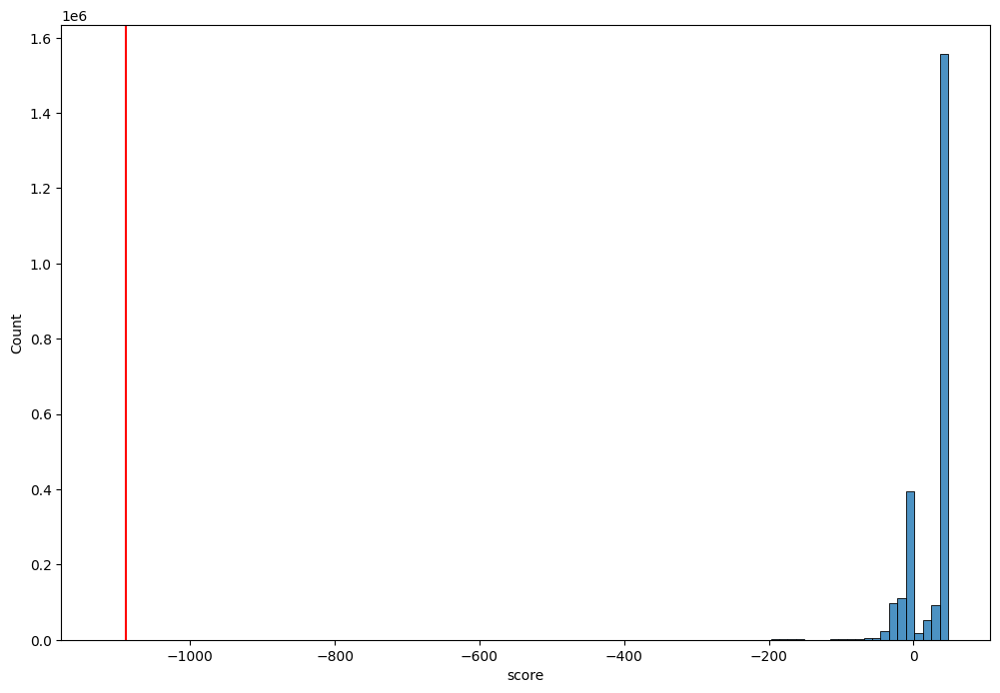

In [ ]:
plt.figure(figsize=(12, 8))
sns.histplot(df["score"], bins=100, alpha=0.8)
plt.axvline(x=-1088.73, color="red")

In [ ]:
value_threshold = -1088.73

df["anomaly_gmm_value"] = df["score"].apply(lambda x: 1 if x < value_threshold else 0)

fig, (ax0, ax1) = plt.subplots(1, 2, sharey=True, figsize=(20, 12))

ax0.set_title('Ground Truth')
ax0.scatter(df['amount'], df['changeOrig'], c=df['isFraud'], cmap='rainbow')

ax1.set_title('GMM Predict Anomalies Using Value')
ax1.scatter(df['amount'], df['changeOrig'], c=df['anomaly_gmm_value'], cmap='rainbow')

### GMM Anomaly Detection Optimization

- Hyperparameter tuning

Because the sample scores are calculated based on the Gaussian Mixture Model, a better model is likely to lead to better scores for anomaly detection.

- Optimize the threshold based on the ground truth.

Take fraud detection as an example, after identifying the outliers based on a certain threshold, people can look into specific cases and decide if it is a true fraud. If there are a lot of false positives, we can lower the threshold, and if there are a lot of false negatives, we can increase the threshold.